### Install MAMBAPY

In [1]:
pip install mambapy

  Using cached mambapy-1.2.0-py3-none-any.whl.metadata (16 kB)
  Using cached torch-2.9.1-cp310-cp310-manylinux_2_28_x86_64.whl.metadata (30 kB)
  Using cached filelock-3.20.3-py3-none-any.whl.metadata (2.1 kB)
  Using cached sympy-1.14.0-py3-none-any.whl.metadata (12 kB)
  Using cached networkx-3.4.2-py3-none-any.whl.metadata (6.3 kB)
  Using cached jinja2-3.1.6-py3-none-any.whl.metadata (2.9 kB)
  Using cached fsspec-2026.1.0-py3-none-any.whl.metadata (10 kB)
  Using cached nvidia_cuda_nvrtc_cu12-12.8.93-py3-none-manylinux2010_x86_64.manylinux_2_12_x86_64.whl.metadata (1.7 kB)
  Using cached nvidia_cuda_runtime_cu12-12.8.90-py3-none-manylinux2014_x86_64.manylinux_2_17_x86_64.whl.metadata (1.7 kB)
  Using cached nvidia_cuda_cupti_cu12-12.8.90-py3-none-manylinux2014_x86_64.manylinux_2_17_x86_64.whl.metadata (1.7 kB)
  Using cached nvidia_cudnn_cu12-9.10.2.21-py3-none-manylinux_2_27_x86_64.whl.metadata (1.8 kB)
  Using cached nvidia_cublas_cu12-12.8.4.1-py3-none-manylinux_2_27_x86_64.wh

### Import libs

In [15]:
import sys

import glob
import os
import pandas as pd
import numpy as np

from dataloaders.params import INPUT_NAMES
from dataloaders.mcd_uwbloader import MCDLoader
from dataloaders.load_data import load_data
from sklearn.preprocessing import MinMaxScaler

import open3d as o3d
import pickle

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.axes_grid1 import make_axes_locatable

# from PIL import Image
# from IPython import display
import seaborn as sns   # For violin plot

from util.eval import Result
from util.trainer import train,validate,network_train
from util.visualization import visualize_sample

import torch
import torch.nn as nn
# from dataloaders.mcd_uwbloader import UwbDataLoader,obtain_scale
from models import mambaNet, rnn_attention
from models.load_model import load_model

### Define the parameters

In [16]:
is_train         = False        # Set to False to skip training, automatically load the pretrained model
save_weights     = True         # whether save weights
training_dataset = 'MCD'        # selected from MCD and RONET
dataset_path     = './data'     # the path for the data dir
training_model   = 'MAMBA'      # selected from [MAMBA,BiLSTM,LSTM,GRU,RNN,BiRNN]
train_one_tag    = False        # only valid train on MCD dataset
train_on_slam    = False        # only valid train on MCD dataset
min_anc          = 1            # filter data at least min_anc number of anchors data is available
batchsize        = 64
seqlen           = 20           # the time length of the input uwb data L
coding_dim       = 128          # the dim of uwb embedding
hiddendim        = 256          # hidden size dimention of RNN based model
num_layers       = 4            # the num of layers for MAMBA
lr               = 0.001        # learning rate
weigt_decay      = 0.9
decay_rate       = 0.5
decay_step       = 20
num_epoch        = 100
device           = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

if training_dataset=="MCD":
    if train_one_tag:
        input_dim    = 10
        output_dim   = 3
    else:
        input_dim    = 20
        output_dim   = 6
else:
    input_dim    = 8
    output_dim   = 2
    train_one_tag = True


save_dir = f"output/{training_dataset}/checkpoints/{training_model}"
log_dir  = f"output/{training_dataset}/logs/{training_model}"
os.makedirs(save_dir,exist_ok=True)
os.makedirs(log_dir,exist_ok=True)
save_path = os.path.join(save_dir,"best_model")
saved_checkpoint_path = save_path  

### Create the dataloader

In [17]:
print(f"Train on {training_dataset} dataset")

if training_dataset=="MCD":
    train_dataset ,val_dataset,train_dataloader,val_dataloader,Xscaler, Yscaler = load_data(seqlen,batchsize,min_anc,training_dataset,train_on_slam,train_one_tag,dataset_path)
    test_dataloader = val_dataloader
else:
    train_dataloader,val_dataloader,test_dataloader, Yscaler = load_data(seqlen,batchsize,min_anc,training_dataset,train_on_slam,train_one_tag,dataset_path)

Train on MCD dataset
['./data/MCDUWB_gndtruth/train/ntu_day_01_packed.csv', './data/MCDUWB_gndtruth/train/ntu_day_03_packed.csv', './data/MCDUWB_gndtruth/train/ntu_day_04_packed.csv', './data/MCDUWB_gndtruth/train/ntu_day_05_packed.csv', './data/MCDUWB_gndtruth/train/ntu_day_06_packed.csv', './data/MCDUWB_gndtruth/train/ntu_day_07_packed.csv', './data/MCDUWB_gndtruth/train/ntu_day_08_packed.csv', './data/MCDUWB_gndtruth/train/ntu_day_09_packed.csv', './data/MCDUWB_gndtruth/train/ntu_night_01_packed.csv', './data/MCDUWB_gndtruth/train/ntu_night_03_packed.csv', './data/MCDUWB_gndtruth/train/ntu_night_05_packed.csv', './data/MCDUWB_gndtruth/train/ntu_night_06_packed.csv', './data/MCDUWB_gndtruth/train/ntu_night_07_packed.csv', './data/MCDUWB_gndtruth/train/ntu_night_08_packed.csv', './data/MCDUWB_gndtruth/train/ntu_night_09_packed.csv', './data/MCDUWB_gndtruth/train/ntu_night_10_packed.csv', './data/MCDUWB_gndtruth/train/ntu_night_11_packed.csv', './data/MCDUWB_gndtruth/train/ntu_night_12

### Create the model

In [21]:
model = load_model(training_model, input_dim,output_dim,coding_dim,num_layers, hiddendim, device)
model = model.to(device)

Num. of parameters:  482694


### Model training

In [25]:
criterion = nn.MSELoss().to(device)
optimizer = torch.optim.Adam(model.parameters(),lr)
if is_train:
    print(f"Train on {training_dataset} dataset, using model {training_model}")
    vis = 1 # 1: plot the loss curve, 0: print the loss value
    res = network_train(model,training_dataset,train_dataloader, val_dataloader, Yscaler, criterion,optimizer,num_epoch,device,lr,decay_rate,decay_step,vis=vis,save_weights=save_weights,save_path=save_path,log_path=log_dir,half=train_one_tag,real=train_on_slam,)
else:
    print(f"Test on {training_dataset} dataset, using model {training_model}")
    model = torch.load(saved_checkpoint_path, weights_only=False, map_location=device).to(device)
    res = validate(test_dataloader, model, training_dataset, 1, 'Test',device,Yscaler,half=train_one_tag)
    print((res))

Test on MCD dataset, using model MAMBA
Epoch:  1. 540 / 541 | Mode: Test. RMSE: 2.228084. MEAN:  0.517114. MEDIAN: 0.156004


### Model testing

In [26]:
print(f"Test on {training_dataset} dataset, the using model is {training_model}, load weights from: {saved_checkpoint_path}")
model = torch.load(saved_checkpoint_path, weights_only=False, map_location=device).to(device)
model.eval()
res = validate(test_dataloader, model, training_dataset, 1, 'Test', device, Yscaler,half=train_one_tag)
print(res)

Test on MCD dataset, the using model is MAMBA, load weights from: output/MCD/checkpoints/MAMBA/best_model
Epoch:  1. 540 / 541 | Mode: Test. RMSE: 2.228084. MEAN:  0.517114. MEDIAN: 0.156004


### Visualize the test results on MCD NTU dataset

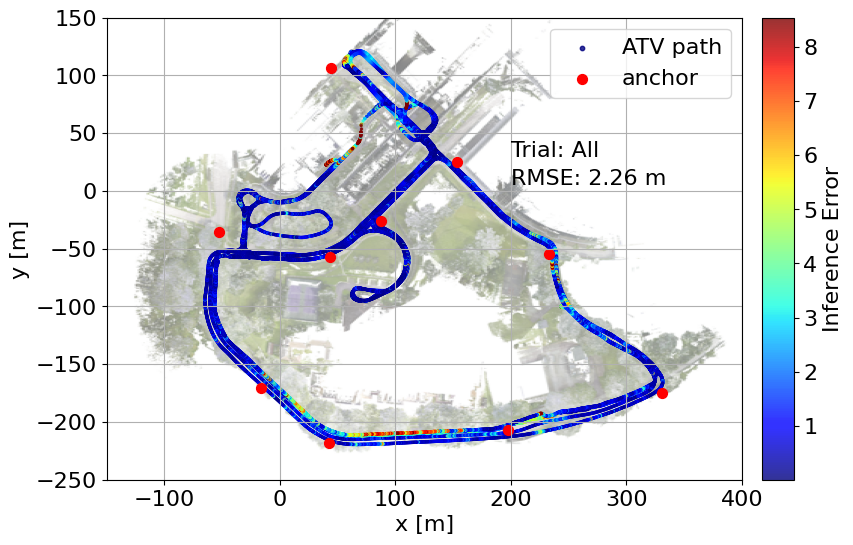

In [27]:
from util.visualization import plotPathError
# Plot the error based on location
test_dataset = val_dataset
# Initialize variables for chunk processing
chunk_size = 1000
total_data = test_dataset.getX().shape[0]
num_chunks = total_data // chunk_size
testErrScaler = MinMaxScaler(feature_range=(0, 1))

# Initialize lists to accumulate results
all_Y = []
all_Ypred = []
all_errors = []

# Iterate over each chunk
for i in range(num_chunks):
    # Load a chunk of data
    X = test_dataset.getX()[i*chunk_size:(i+1)*chunk_size, :, :]
    Y = test_dataset.getY()[i*chunk_size:(i+1)*chunk_size, :, :]
    Y = torch.cat((Y[0, :, :], Y[:, -1, :]), dim=0)
    Y = Yscaler.inverse_transform(Y.cpu())

    Ypred = model(X.float().to(device)).cpu().detach()
    Ypred = torch.cat((Ypred[0, :, :], Ypred[:, -1, :]), dim=0)
    Ypred = Yscaler.inverse_transform(Ypred.cpu())

    test_res = Result(half=train_one_tag)
    test_res.evaluate(Ypred, Y)
    test_err = np.linalg.norm(test_res.abs_diff, axis=1)

    # Accumulate results
    all_Y.append(Y)
    all_Ypred.append(Ypred)
    all_errors.append(test_err)

    # Clear memory for this chunk
    del X, Y, Ypred, test_res, test_err
    torch.cuda.empty_cache()

# Combine accumulated results into a single array
all_Y = np.vstack(all_Y)
all_Ypred = np.vstack(all_Ypred)
all_errors = np.concatenate(all_errors)

# Calculate global statistics for error clamping
mean = np.mean(all_errors)
colorScalePiv = mean + 2 * np.var(all_errors)

# Clamp the error color globally
all_errors[all_errors > colorScalePiv] = colorScalePiv

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(12,6))
all_Y, all_Ypred = plotPathError(all_Y, all_Ypred, ax,colorScalePiv, train_on_slam, train_one_tag, trial='All')

### Plot the error for each sequence

Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_01_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_01_packed.csv. Size: 67
Number of samples: 11243
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_02_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_02_packed.csv. Size: 67
Number of samples: 4535
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_03_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_03_packed.csv. Size: 67
Number of samples: 8374
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_04_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_04_packed.csv. Size: 67
Number of samples: 6903
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_05_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_05_packed.csv. Size: 67
Number of samples: 4886
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_06_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_06_packed.csv. Size: 67
Number of samples: 5398
Path is n

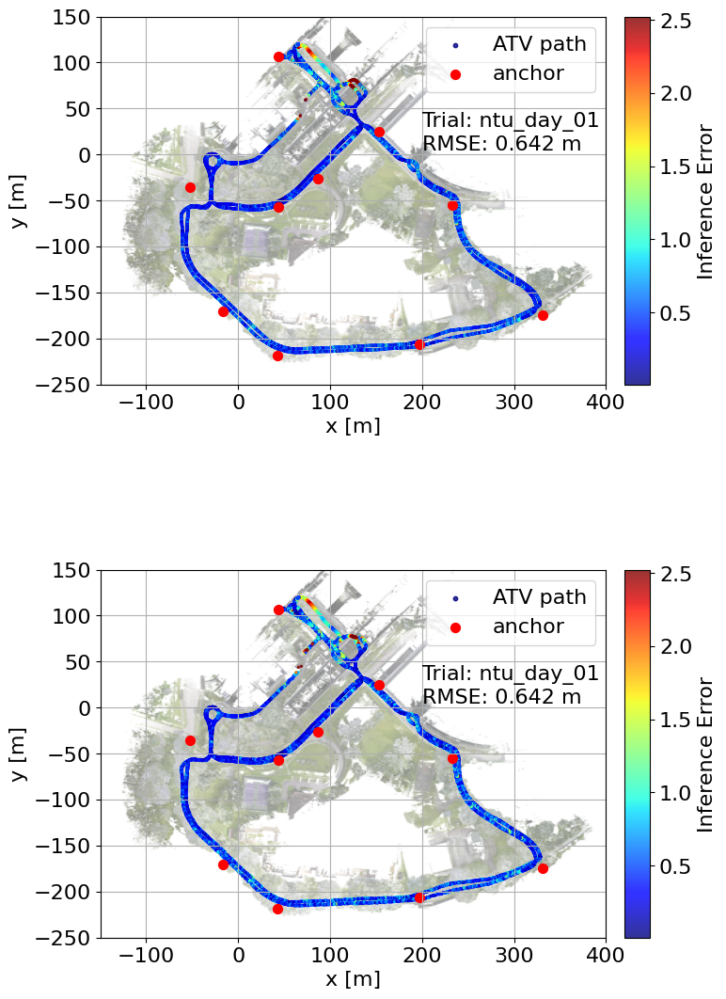

[1/23] ntu_day_01  RMSE(pos) ≈ 0.6415 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_02_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_02_packed.csv. Size: 67
Number of samples: 4535


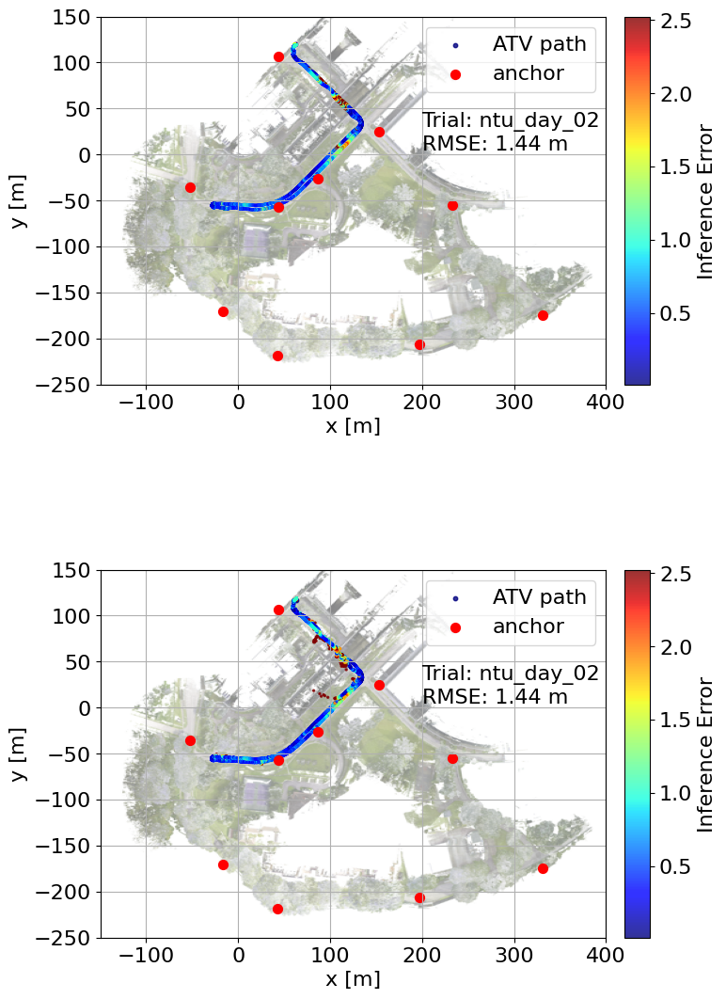

[2/23] ntu_day_02  RMSE(pos) ≈ 1.4432 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_03_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_03_packed.csv. Size: 67
Number of samples: 8374


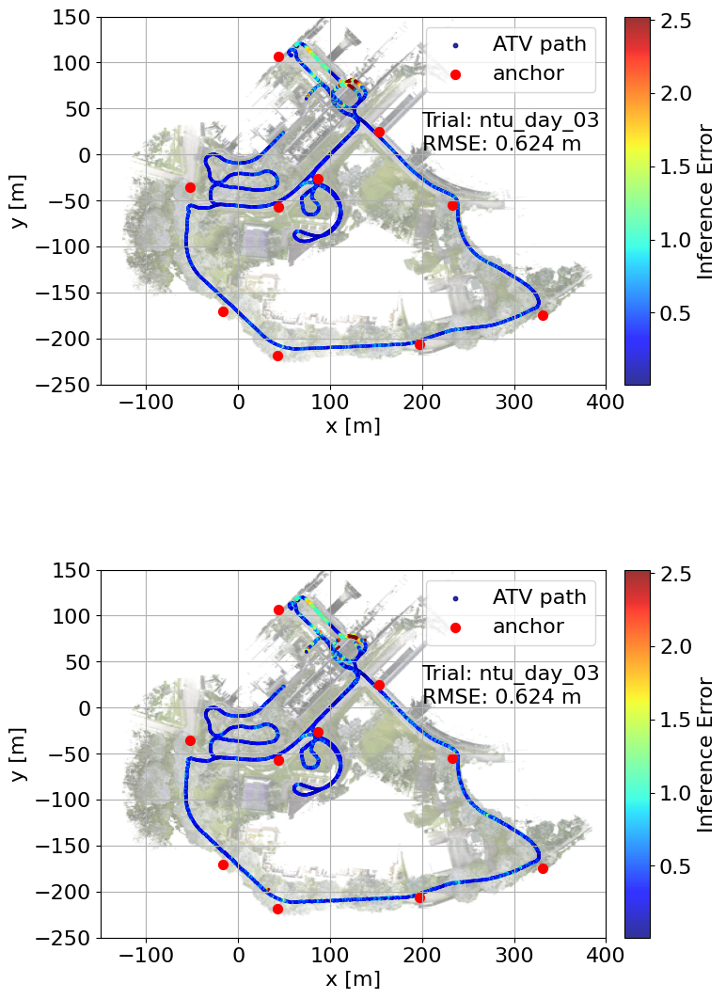

[3/23] ntu_day_03  RMSE(pos) ≈ 0.6243 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_04_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_04_packed.csv. Size: 67
Number of samples: 6903


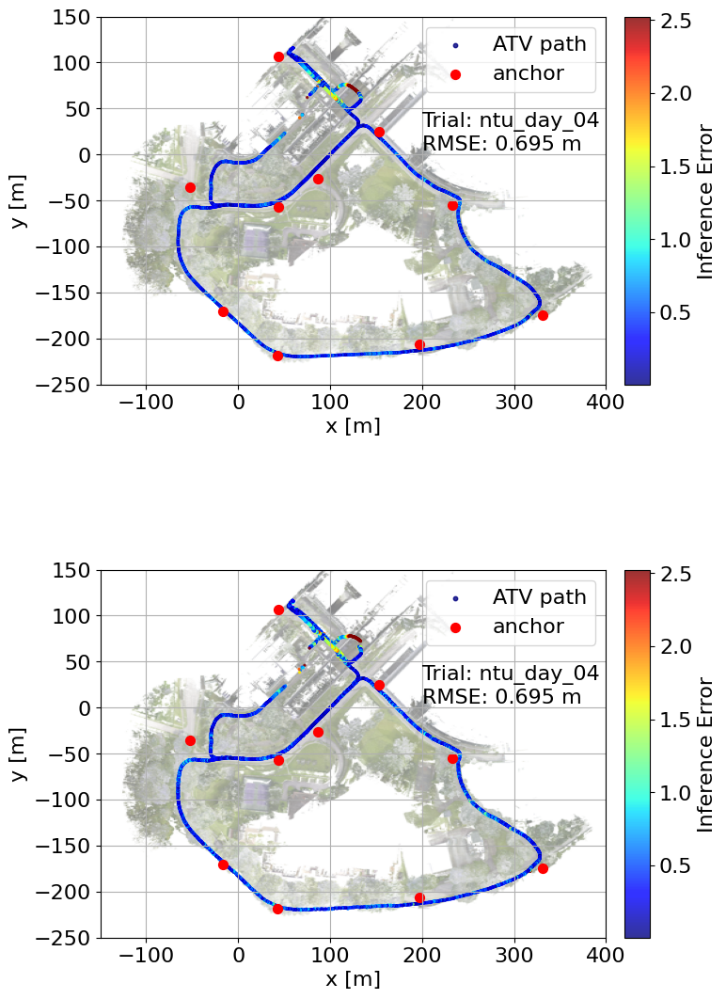

[4/23] ntu_day_04  RMSE(pos) ≈ 0.6949 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_05_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_05_packed.csv. Size: 67
Number of samples: 4886


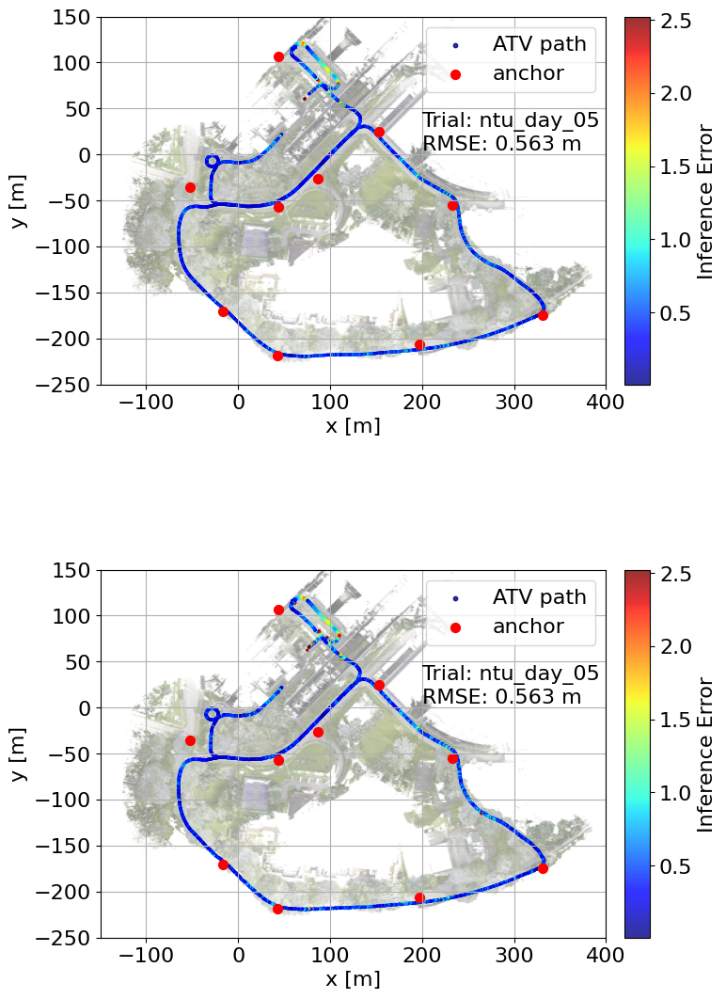

[5/23] ntu_day_05  RMSE(pos) ≈ 0.5626 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_06_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_06_packed.csv. Size: 67
Number of samples: 5398


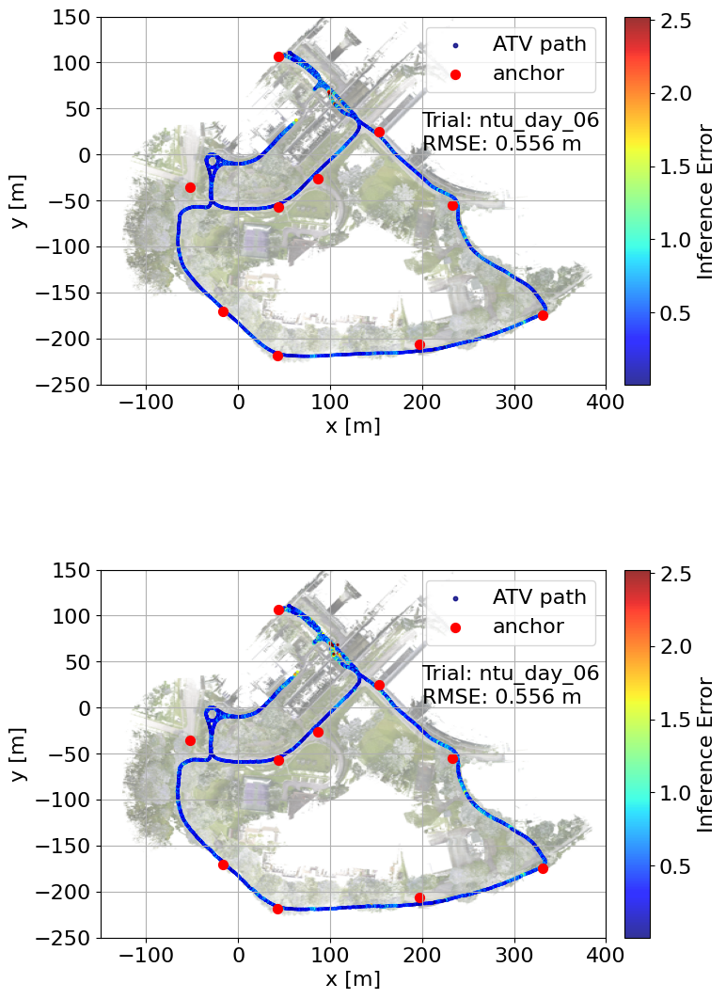

[6/23] ntu_day_06  RMSE(pos) ≈ 0.5556 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_07_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_07_packed.csv. Size: 67
Number of samples: 10495


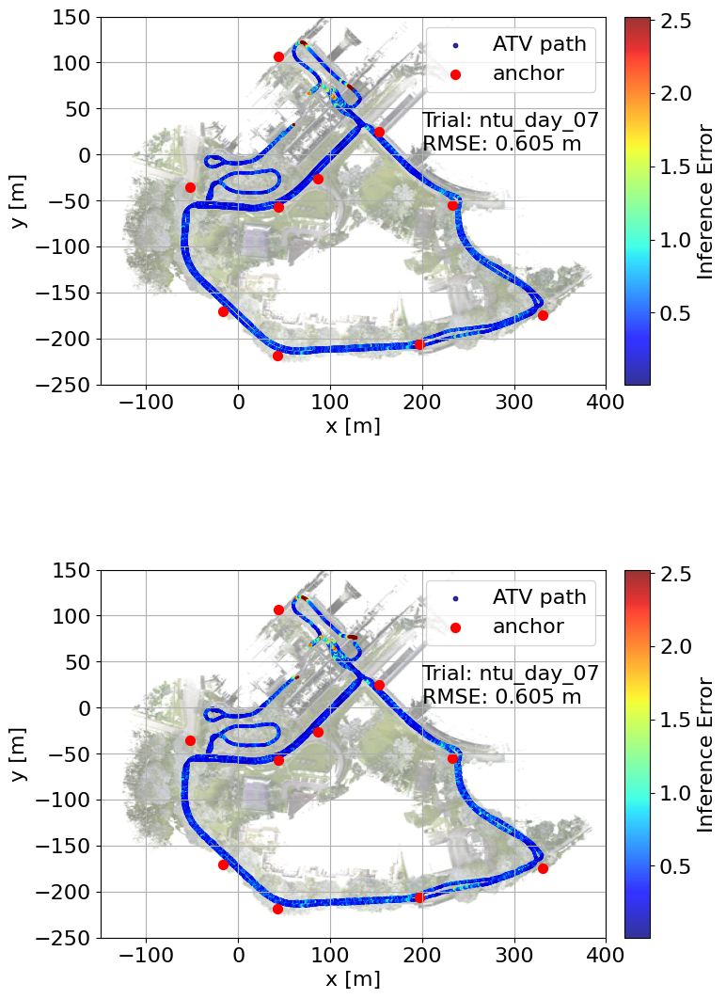

[7/23] ntu_day_07  RMSE(pos) ≈ 0.6049 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_08_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_08_packed.csv. Size: 67
Number of samples: 10859


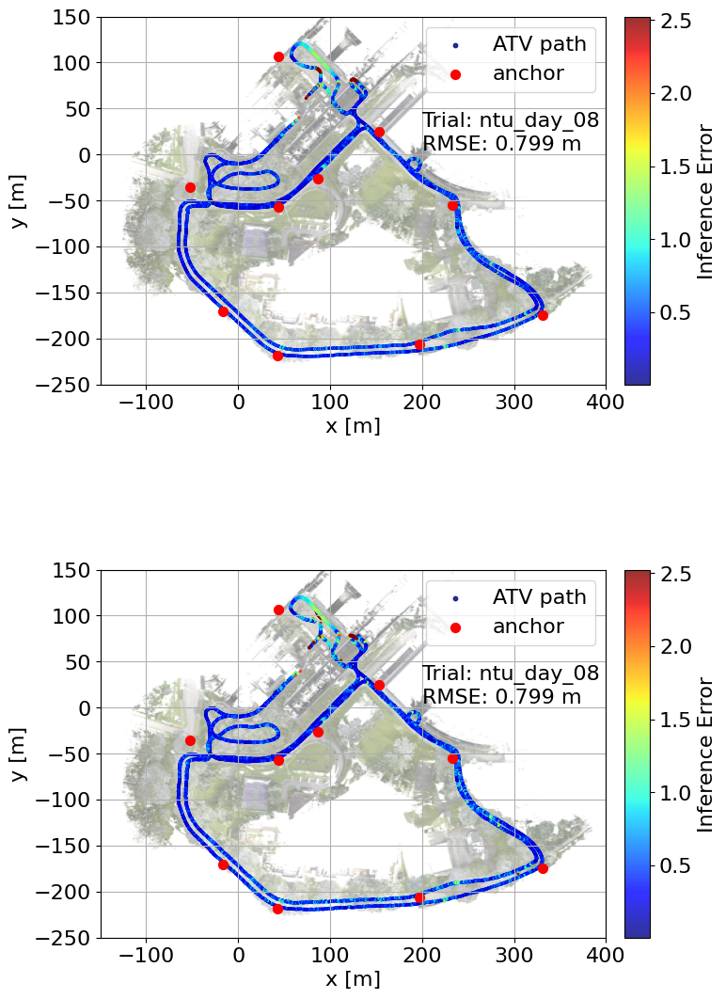

[8/23] ntu_day_08  RMSE(pos) ≈ 0.7988 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_09_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_09_packed.csv. Size: 67
Number of samples: 6029


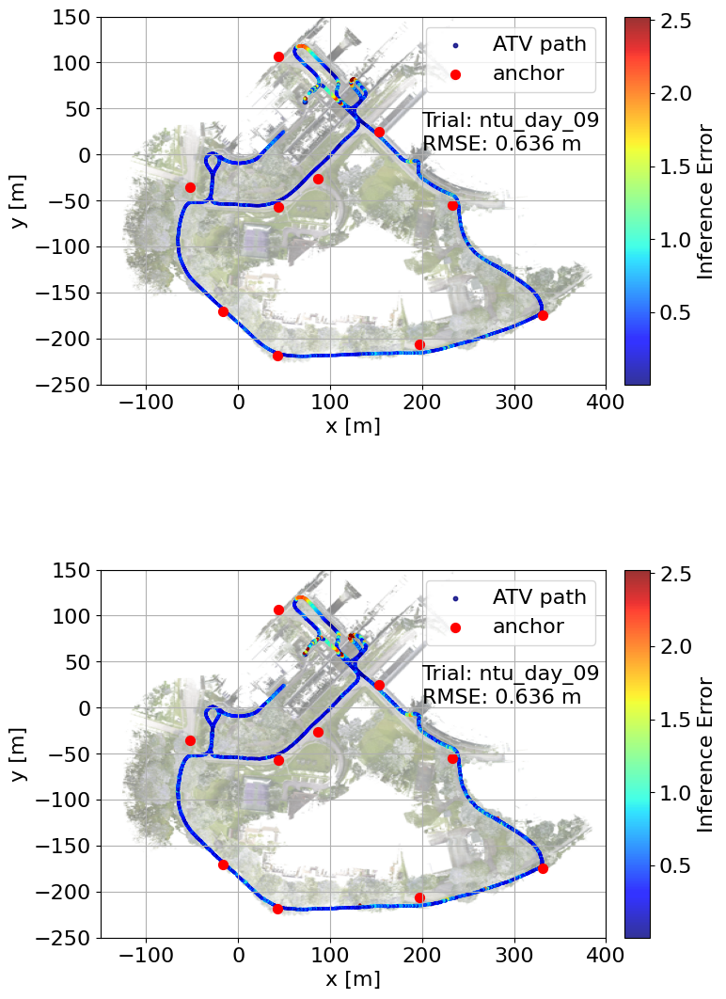

[9/23] ntu_day_09  RMSE(pos) ≈ 0.6361 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_10_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_10_packed.csv. Size: 67
Number of samples: 6365


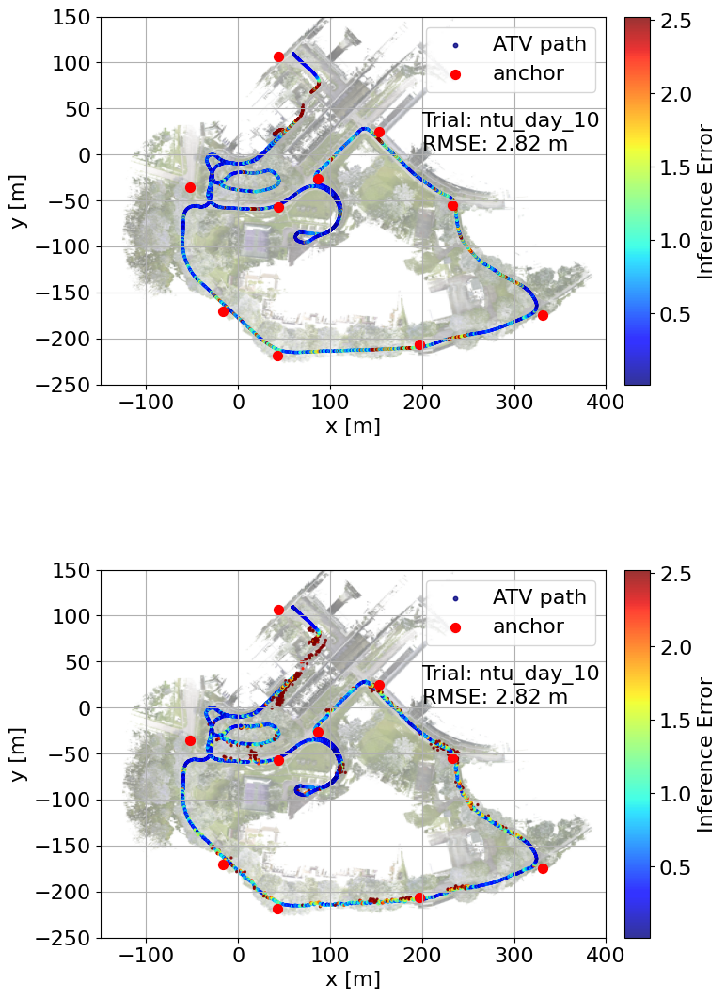

[10/23] ntu_day_10  RMSE(pos) ≈ 2.8246 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_01_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_01_packed.csv. Size: 67
Number of samples: 7368


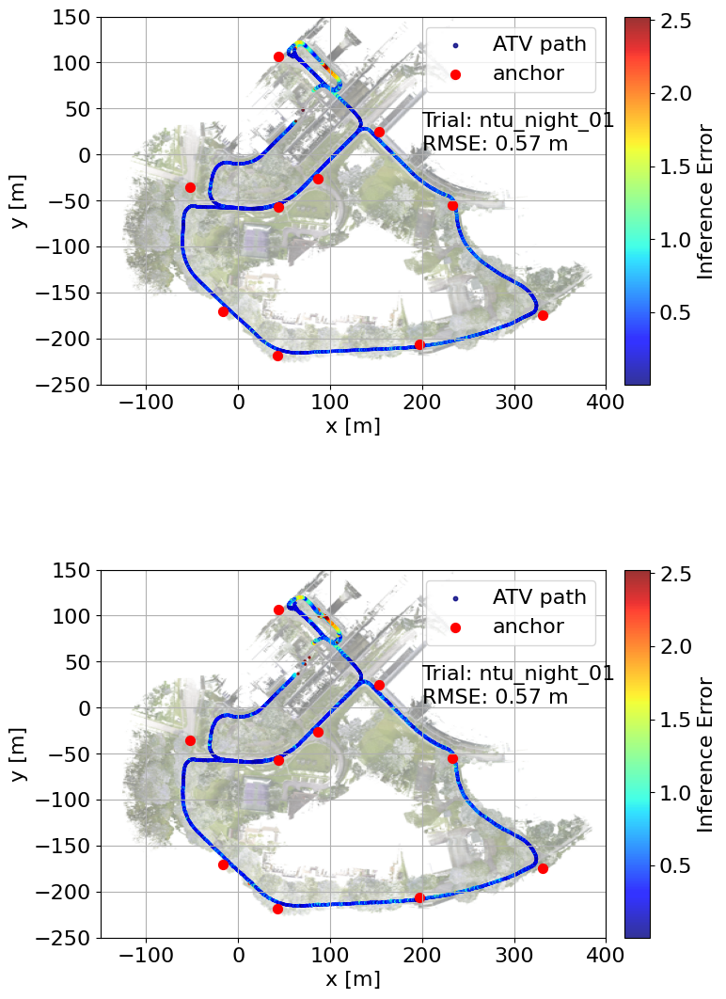

[11/23] ntu_night_01  RMSE(pos) ≈ 0.5704 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_02_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_02_packed.csv. Size: 67
Number of samples: 13235


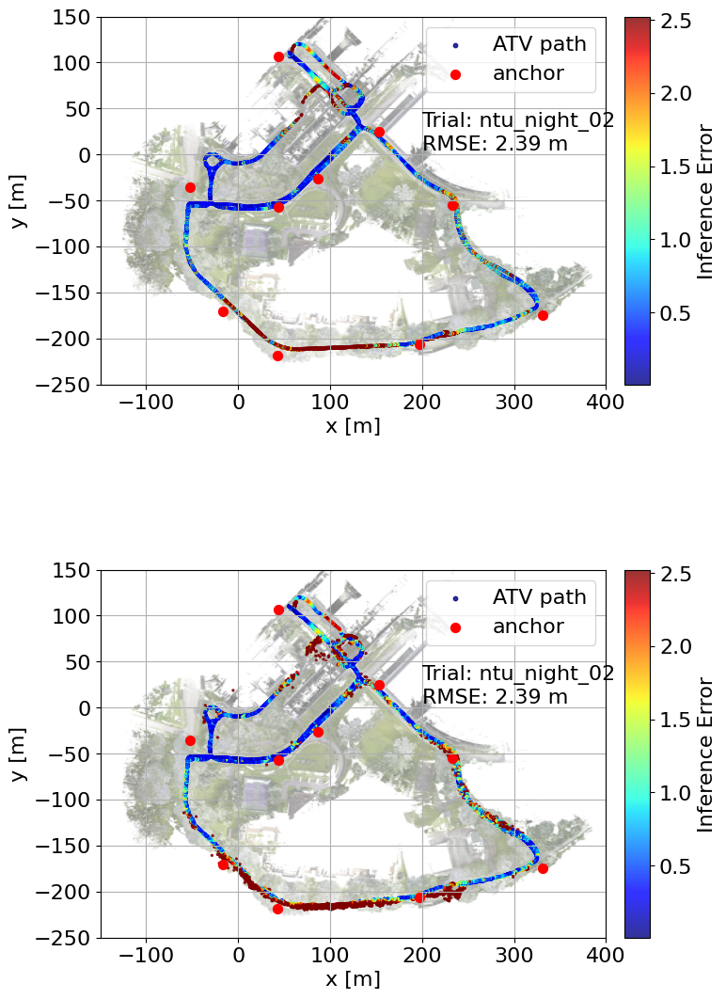

[12/23] ntu_night_02  RMSE(pos) ≈ 2.3895 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_03_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_03_packed.csv. Size: 67
Number of samples: 6593


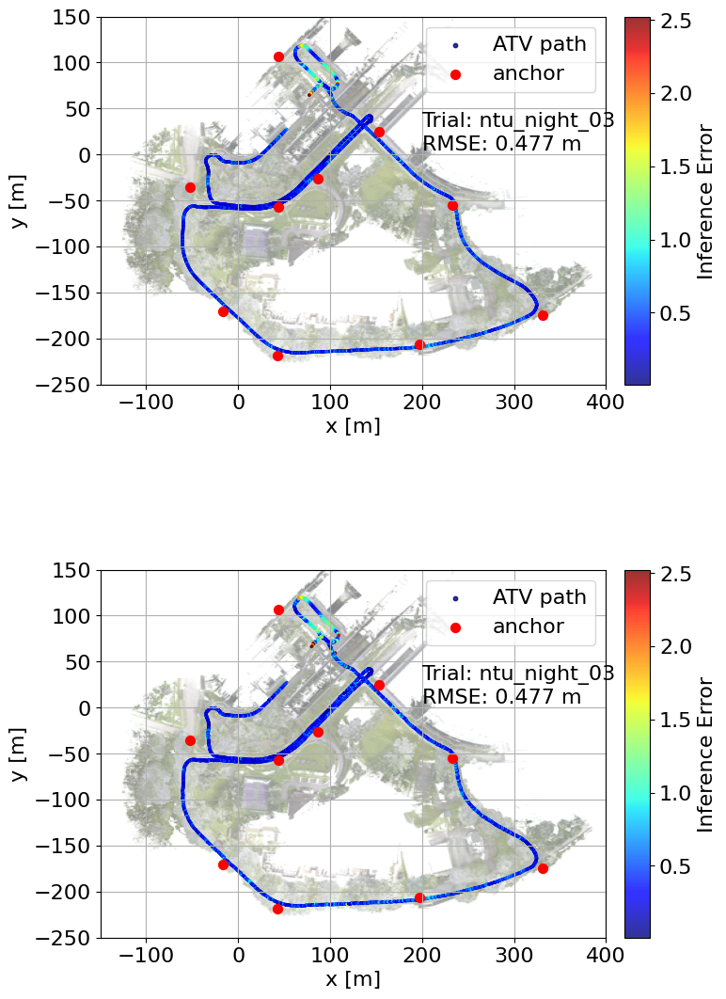

[13/23] ntu_night_03  RMSE(pos) ≈ 0.4772 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_04_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_04_packed.csv. Size: 67
Number of samples: 5787


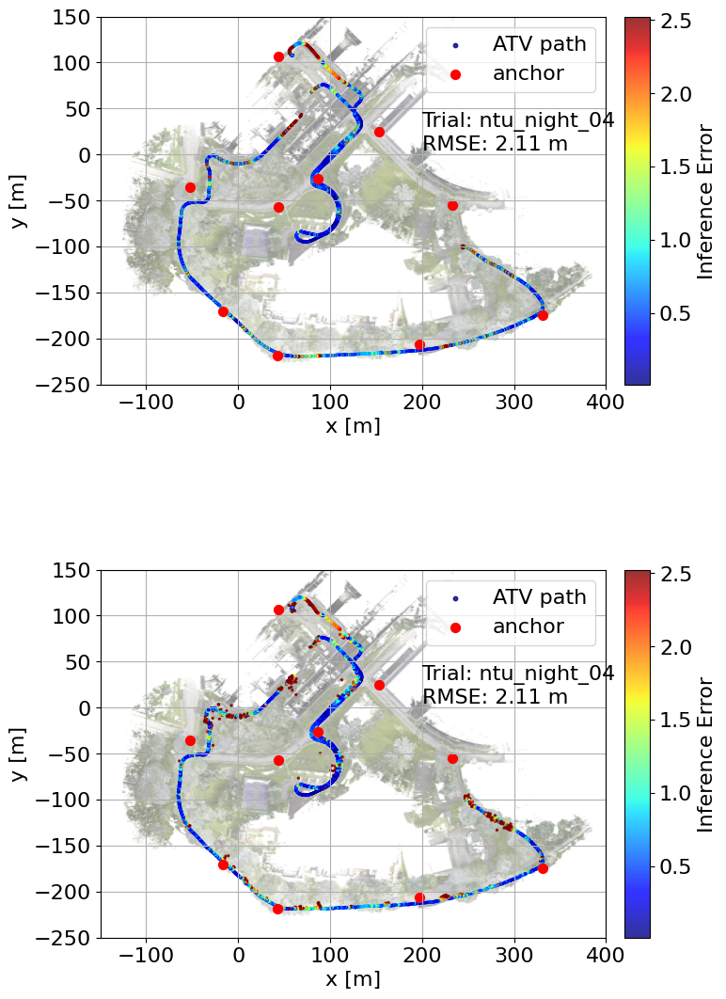

[14/23] ntu_night_04  RMSE(pos) ≈ 2.1109 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_05_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_05_packed.csv. Size: 67
Number of samples: 10483


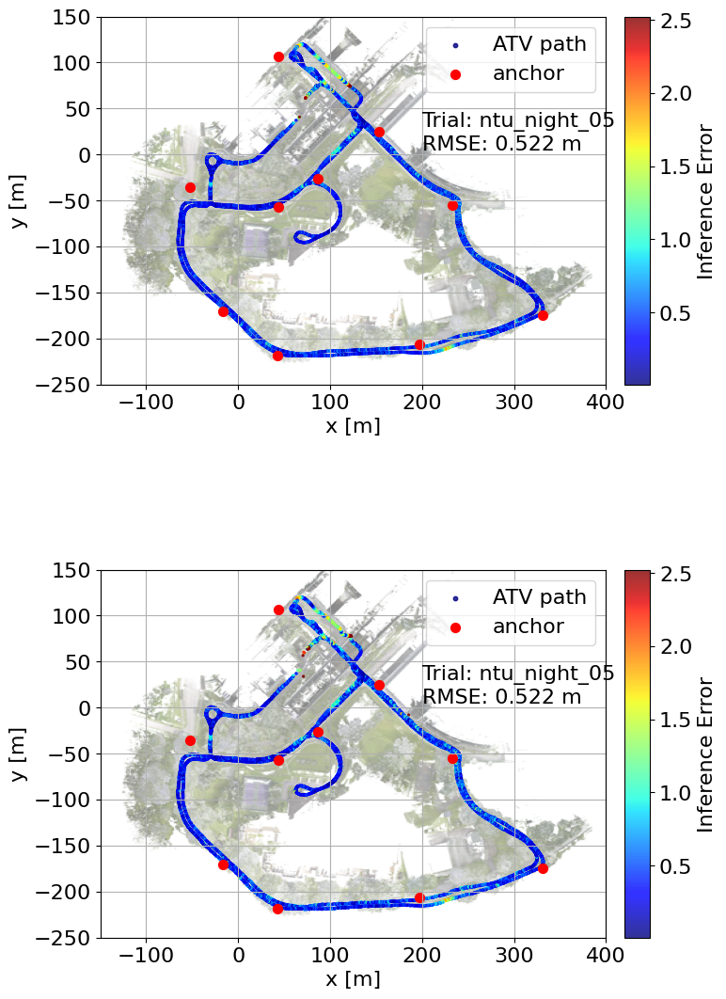

[15/23] ntu_night_05  RMSE(pos) ≈ 0.5224 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_06_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_06_packed.csv. Size: 67
Number of samples: 9146


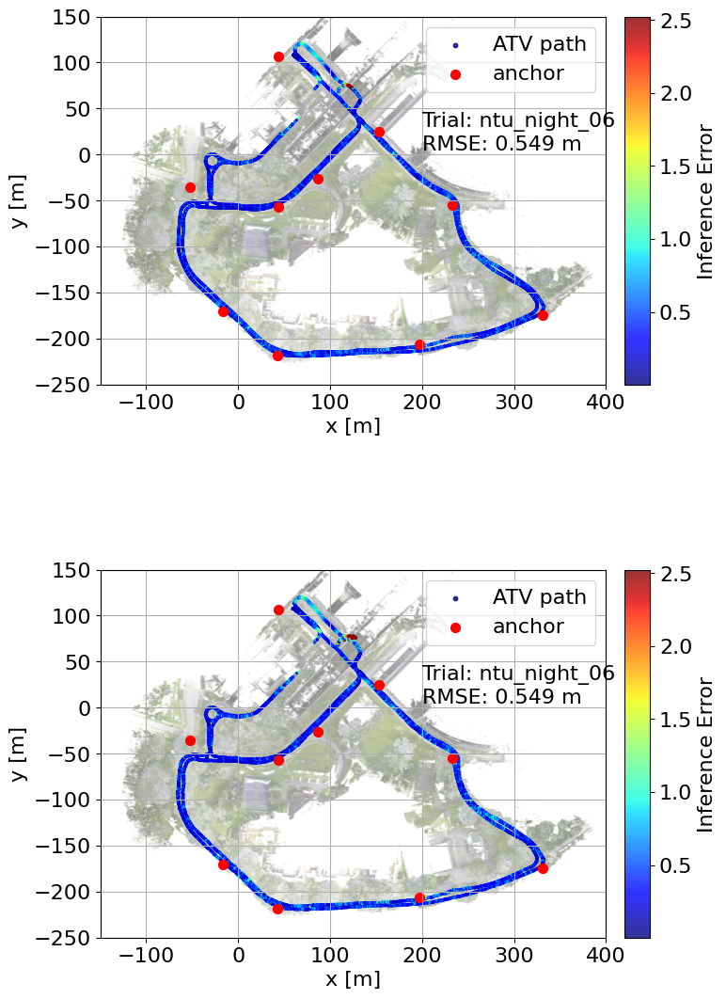

[16/23] ntu_night_06  RMSE(pos) ≈ 0.5493 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_07_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_07_packed.csv. Size: 67
Number of samples: 7855


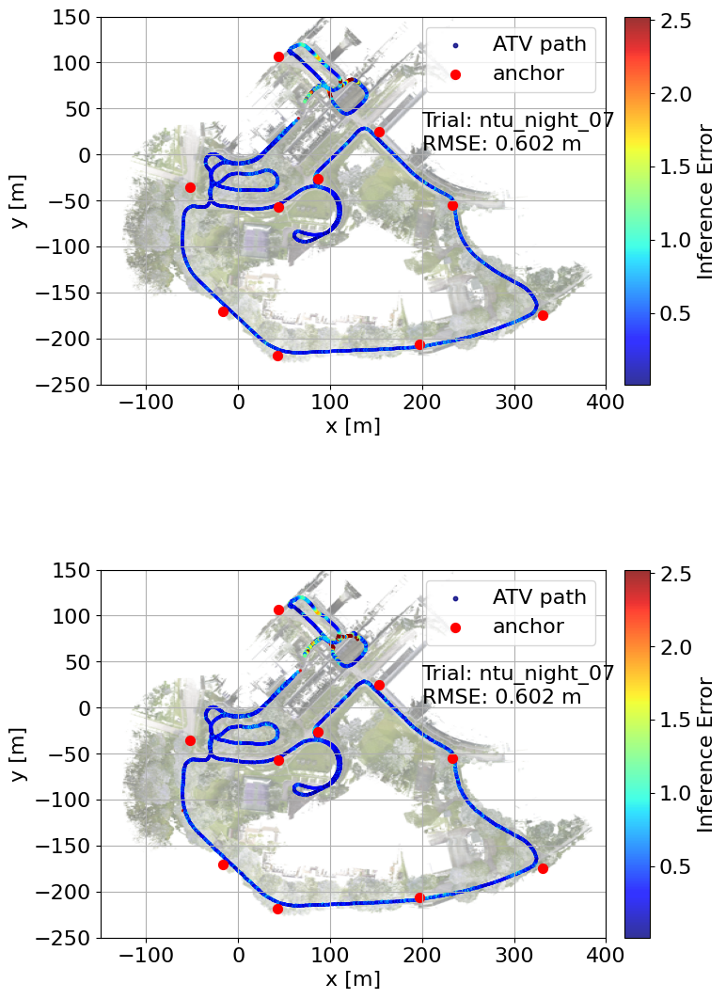

[17/23] ntu_night_07  RMSE(pos) ≈ 0.6025 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_08_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_08_packed.csv. Size: 67
Number of samples: 8540


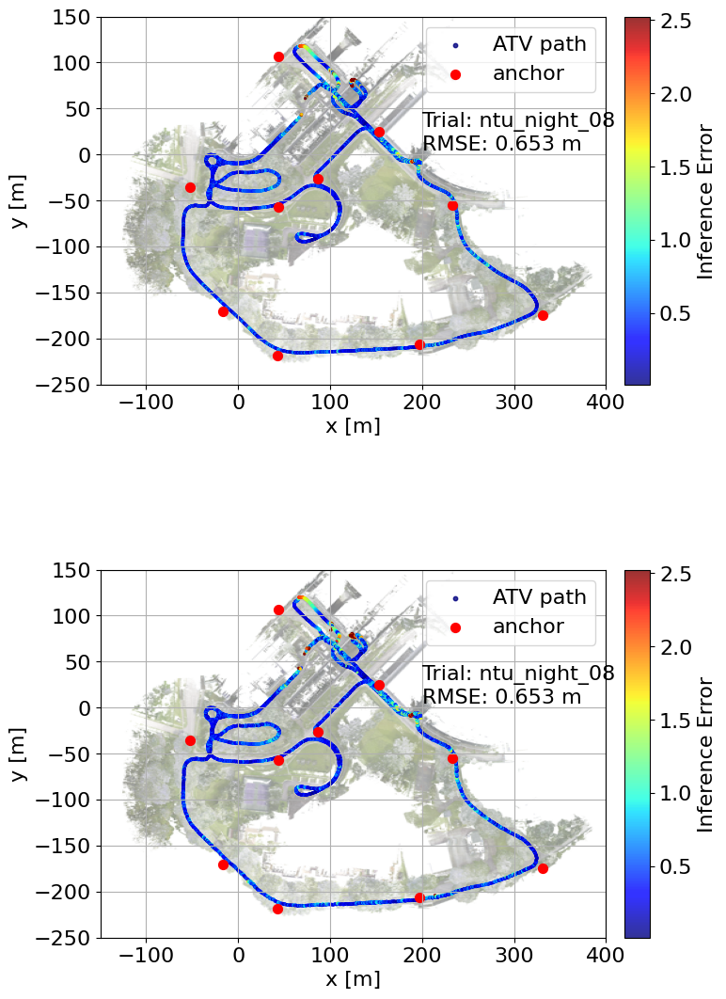

[18/23] ntu_night_08  RMSE(pos) ≈ 0.6529 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_09_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_09_packed.csv. Size: 67
Number of samples: 4777


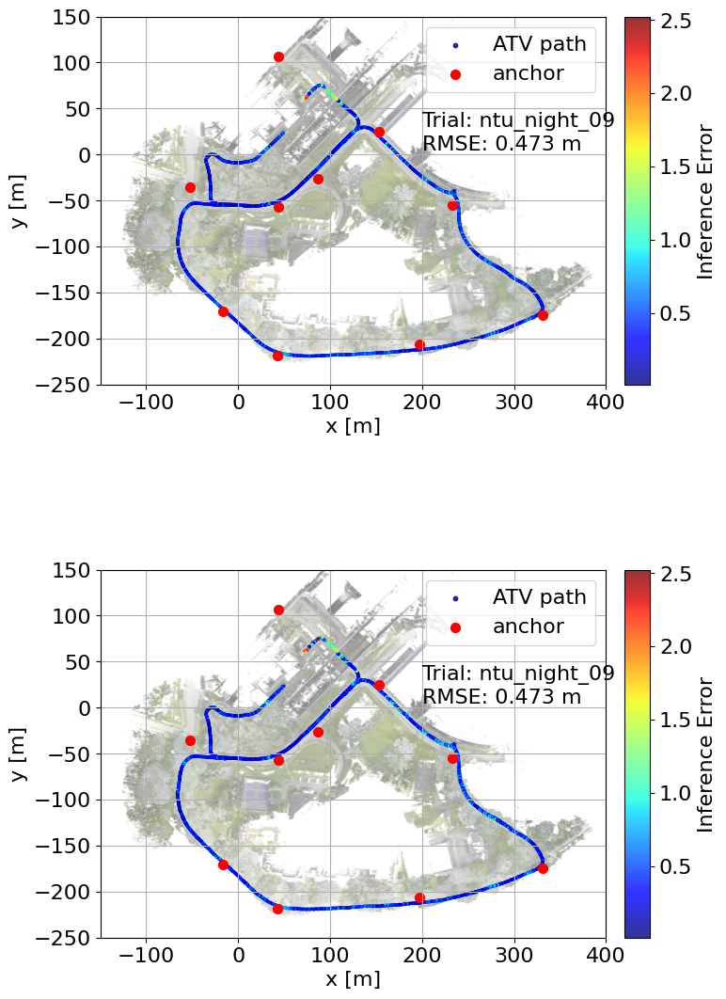

[19/23] ntu_night_09  RMSE(pos) ≈ 0.4731 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_10_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_10_packed.csv. Size: 67
Number of samples: 8438


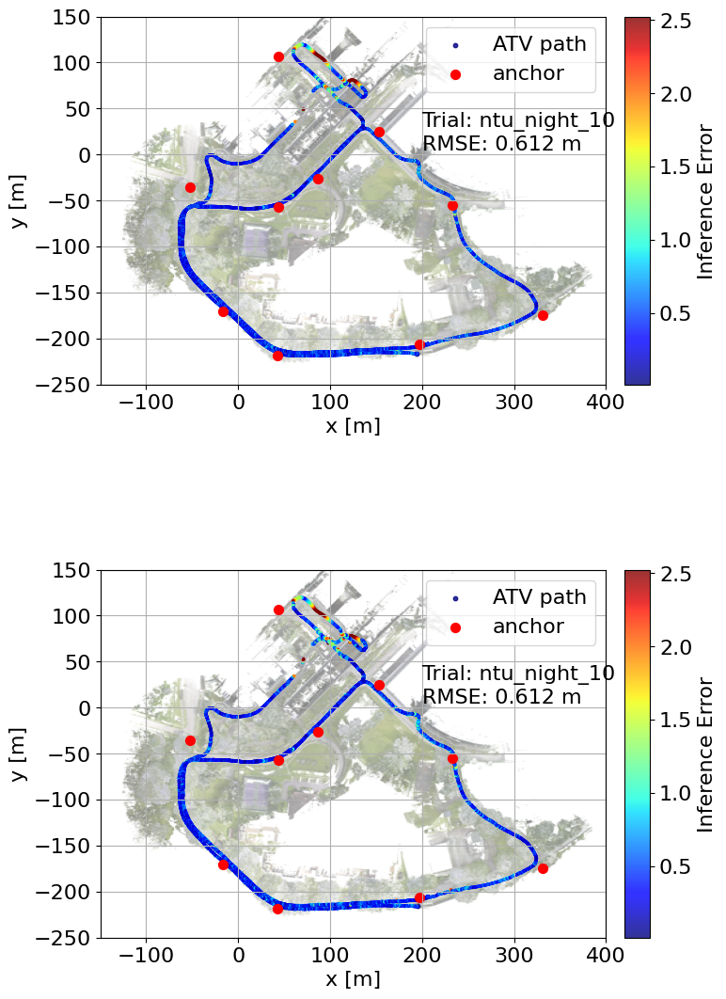

[20/23] ntu_night_10  RMSE(pos) ≈ 0.6119 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_11_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_11_packed.csv. Size: 67
Number of samples: 7512


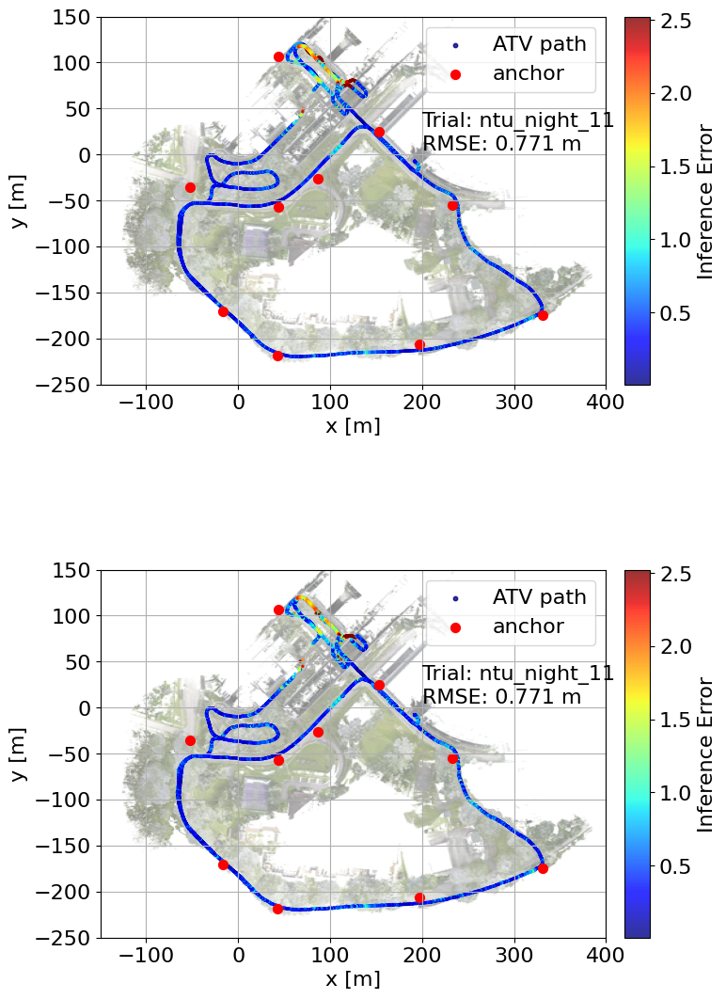

[21/23] ntu_night_11  RMSE(pos) ≈ 0.7711 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_12_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_12_packed.csv. Size: 67
Number of samples: 4776


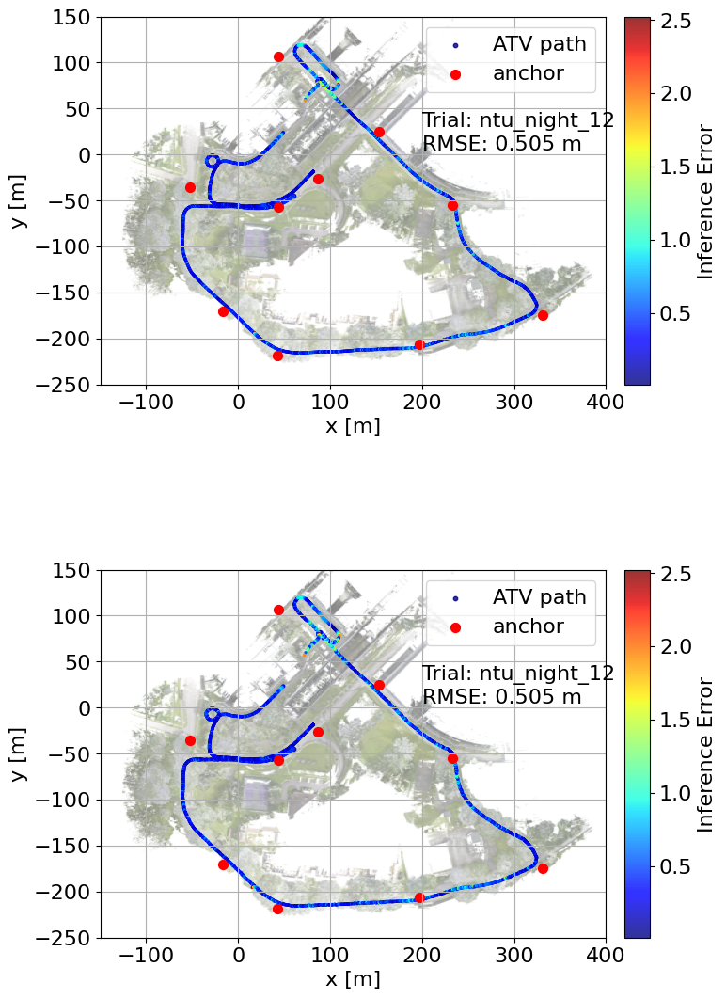

[22/23] ntu_night_12  RMSE(pos) ≈ 0.5053 m
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_13_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_13_packed.csv. Size: 67
Number of samples: 4640


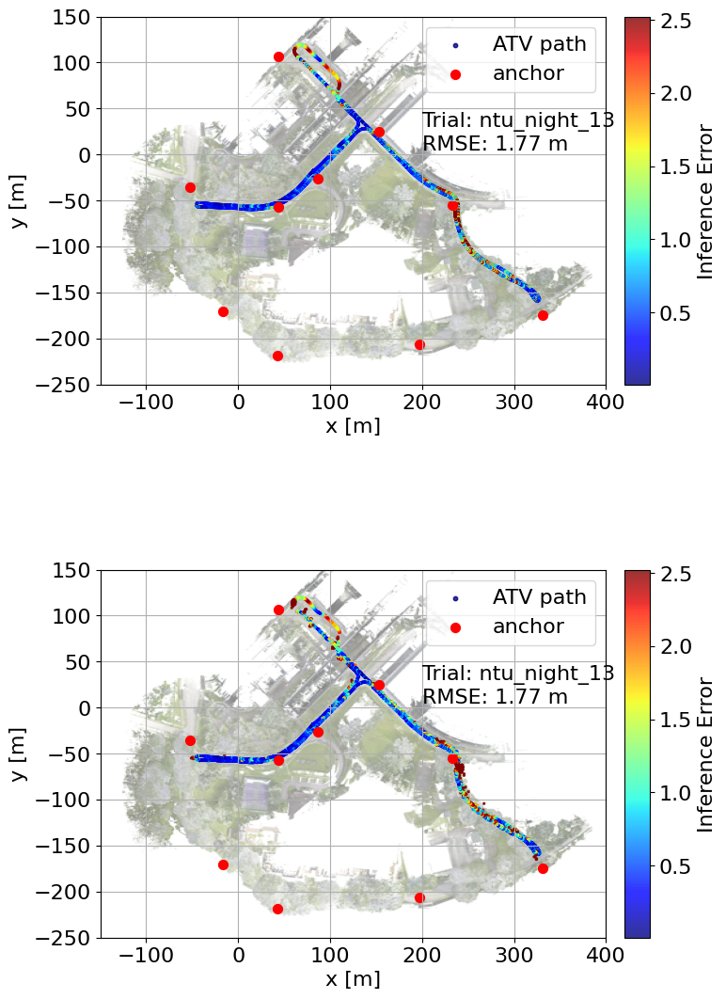

[23/23] ntu_night_13  RMSE(pos) ≈ 1.7676 m


In [30]:
import os, glob, math
import numpy as np
import pandas as pd
import torch
import matplotlib.pyplot as plt

from util.visualization import plotPathError

# ------------------ Select test path ------------------
if train_on_slam:
    test_path = os.path.join(dataset_path, "MCDUWB_slamprior/test")
else:
    test_path = os.path.join(dataset_path, "MCDUWB_gndtruth/all")

chunk_size = 1000
test_seq = sorted(glob.glob(test_path + '/*.csv'))
figsize = (8, 12)

model.eval()

# ======================================================
# PASS 1: compute global errors to get global colorScalePiv
# ======================================================
all_err_global = []

with torch.no_grad():
    for seq in test_seq:
        seq_name = os.path.basename(seq).replace('_packed.csv', '')

        seq_dataset = MCDLoader(
            seq, seqlen=seqlen, Xscaler=Xscaler, Yscaler=Yscaler,
            min_anc=min_anc, half=train_one_tag
        )

        X = seq_dataset.getX()
        Y = seq_dataset.getY()

        total_data = X.shape[0]
        num_chunks = math.ceil(total_data / chunk_size)

        for i in range(num_chunks):
            s = i * chunk_size
            e = min((i + 1) * chunk_size, total_data)

            X_chunk = X[s:e, :, :]
            Y_chunk = Y[s:e, :, :]

            # reconstruct trajectory points
            Y_chunk = torch.cat((Y_chunk[0, :, :], Y_chunk[:, -1, :]), dim=0)   # (L + B, dim)
            Y_chunk = Yscaler.inverse_transform(Y_chunk.cpu().numpy())

            # predict
            Ypred_chunk = model(X_chunk.float().to(device)).cpu()
            Ypred_chunk = torch.cat((Ypred_chunk[0, :, :], Ypred_chunk[:, -1, :]), dim=0)
            Ypred_chunk = Yscaler.inverse_transform(Ypred_chunk.numpy())

            # error
            chunk_res = Result(half=train_one_tag)
            chunk_res.evaluate(Ypred_chunk, Y_chunk)
            chunk_err = np.linalg.norm(chunk_res.abs_diff, axis=1)

            all_err_global.append(chunk_err)

            del X_chunk, Y_chunk, Ypred_chunk, chunk_res, chunk_err
            torch.cuda.empty_cache()

# global clamp scale
all_err_global = np.concatenate(all_err_global)
mean = np.mean(all_err_global)
colorScalePiv = mean + 2 * np.var(all_err_global)
print(f"[Global] colorScalePiv = {colorScalePiv:.4f}")

# ======================================================
# PASS 2: plot each sequence with global colorScalePiv
# ======================================================
test_df = None

with torch.no_grad():
    for seqidx, seq in enumerate(test_seq):
        seq_name = os.path.basename(seq).replace('_packed.csv', '')

        seq_dataset = MCDLoader(
            seq, seqlen=seqlen, Xscaler=Xscaler, Yscaler=Yscaler,
            min_anc=min_anc, half=train_one_tag
        )
        X = seq_dataset.getX()
        Y = seq_dataset.getY()

        total_data = X.shape[0]
        num_chunks = math.ceil(total_data / chunk_size)

        all_Y = []
        all_Ypred = []

        for i in range(num_chunks):
            s = i * chunk_size
            e = min((i + 1) * chunk_size, total_data)

            X_chunk = X[s:e, :, :]
            Y_chunk = Y[s:e, :, :]

            # GT
            Y_chunk = torch.cat((Y_chunk[0, :, :], Y_chunk[:, -1, :]), dim=0)
            Y_chunk = Yscaler.inverse_transform(Y_chunk.cpu().numpy())

            # Pred
            Ypred_chunk = model(X_chunk.float().to(device)).cpu()
            Ypred_chunk = torch.cat((Ypred_chunk[0, :, :], Ypred_chunk[:, -1, :]), dim=0)
            Ypred_chunk = Yscaler.inverse_transform(Ypred_chunk.numpy())

            all_Y.append(Y_chunk)
            all_Ypred.append(Ypred_chunk)

            del X_chunk, Y_chunk, Ypred_chunk
            torch.cuda.empty_cache()

        all_Y = np.vstack(all_Y)
        all_Ypred = np.vstack(all_Ypred)

        # Evaluate sequence errors
        seq_res = Result(half=train_one_tag)
        seq_res.evaluate(all_Ypred, all_Y)
        err = np.linalg.norm(seq_res.abs_diff, axis=1)

        # Save for later
        df = pd.DataFrame(err, columns=['error'])
        df['seq'] = seq_name
        test_df = df if test_df is None else pd.concat([test_df, df], ignore_index=True)

        # Plot
        fig, ax = plt.subplots(nrows=2, ncols=1, figsize=figsize)
        plotPathError(all_Y, all_Ypred, ax[0], colorScalePiv, train_on_slam, train_one_tag, trial=seq_name)
        plotPathError(all_Ypred, all_Y, ax[1], colorScalePiv, train_on_slam, train_one_tag, trial=seq_name)
        plt.tight_layout()
        plt.show()

        print(f"[{seqidx+1}/{len(test_seq)}] {seq_name}  RMSE(pos) ≈ {np.sqrt(np.mean(err**2)):.4f} m")


[INFO] Found test sequences: 23
  - ntu_day_01_packed.csv
  - ntu_day_02_packed.csv
  - ntu_day_03_packed.csv
  - ntu_day_04_packed.csv
  - ntu_day_05_packed.csv
  - ntu_day_06_packed.csv
  - ntu_day_07_packed.csv
  - ntu_day_08_packed.csv
  - ntu_day_09_packed.csv
  - ntu_day_10_packed.csv
  - ntu_night_01_packed.csv
  - ntu_night_02_packed.csv
  - ntu_night_03_packed.csv
  - ntu_night_04_packed.csv
  - ntu_night_05_packed.csv
  - ntu_night_06_packed.csv
  - ntu_night_07_packed.csv
  - ntu_night_08_packed.csv
  - ntu_night_09_packed.csv
  - ntu_night_10_packed.csv
  - ntu_night_11_packed.csv
  - ntu_night_12_packed.csv
  - ntu_night_13_packed.csv
[INFO] XYZ logs will be saved to: output/MCD/logs/MAMBA/xyz_logs_test

[PASS1] (1/23) Compute global error scale for: ntu_day_01
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_01_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_01_packed.csv. Size: 67
Number of samples: 11243

[PASS1] (2/23) Compute global error scale for: n

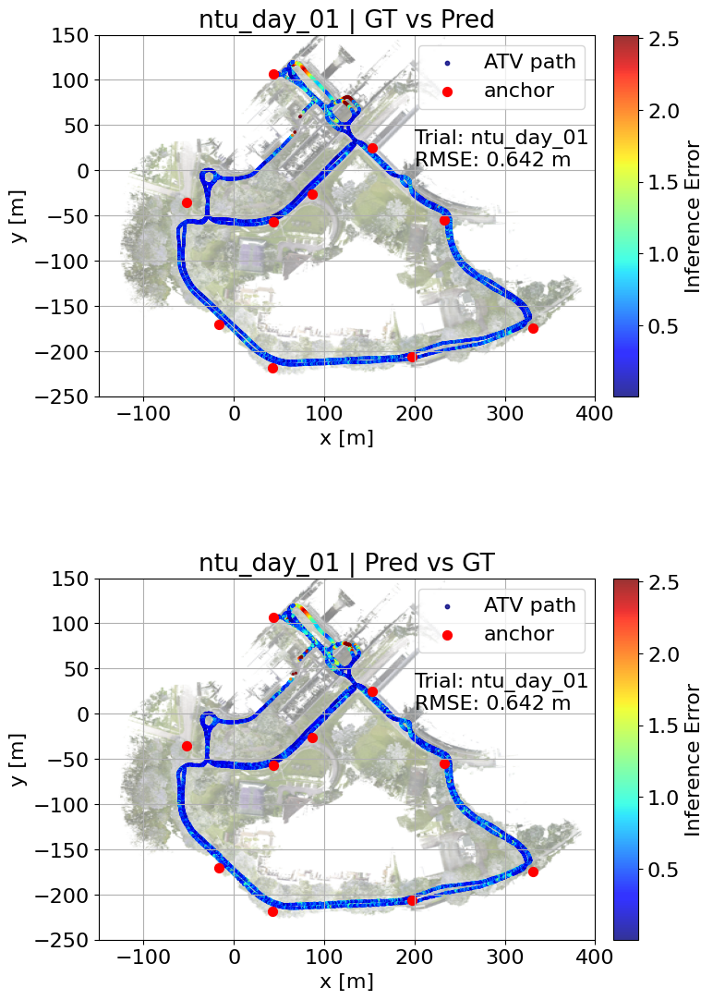


[PASS2] (2/23) Test & Plot: ntu_day_02
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_02_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_02_packed.csv. Size: 67
Number of samples: 4535
[RESULT] ntu_day_02 | RMSE ≈ 1.4432 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_02_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_02_pred_xyz.csv


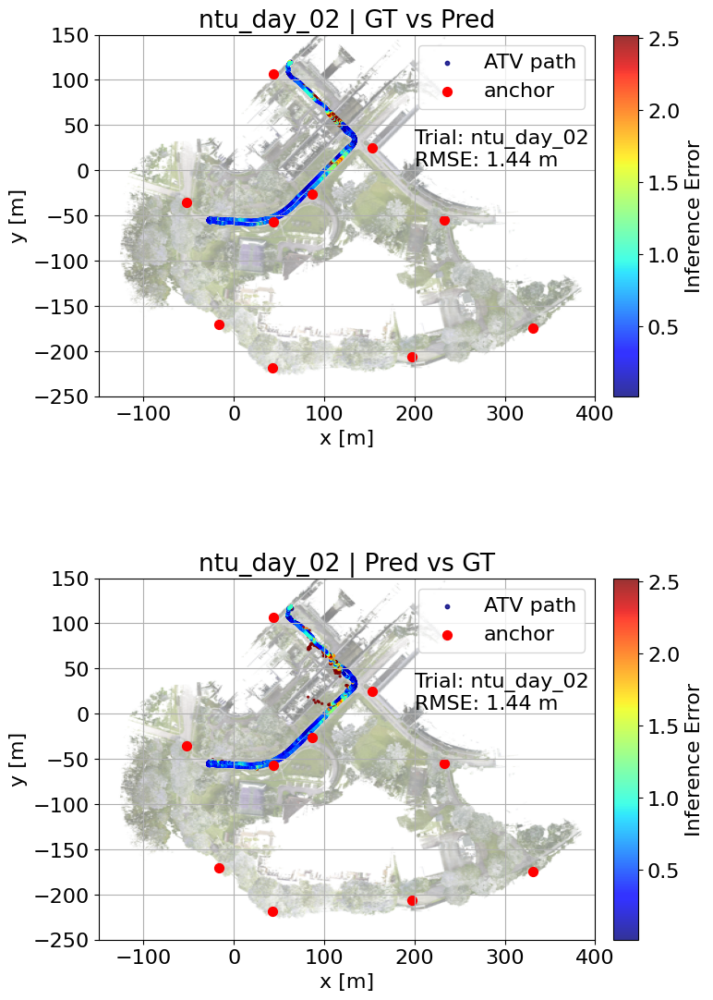


[PASS2] (3/23) Test & Plot: ntu_day_03
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_03_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_03_packed.csv. Size: 67
Number of samples: 8374
[RESULT] ntu_day_03 | RMSE ≈ 0.6243 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_03_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_03_pred_xyz.csv


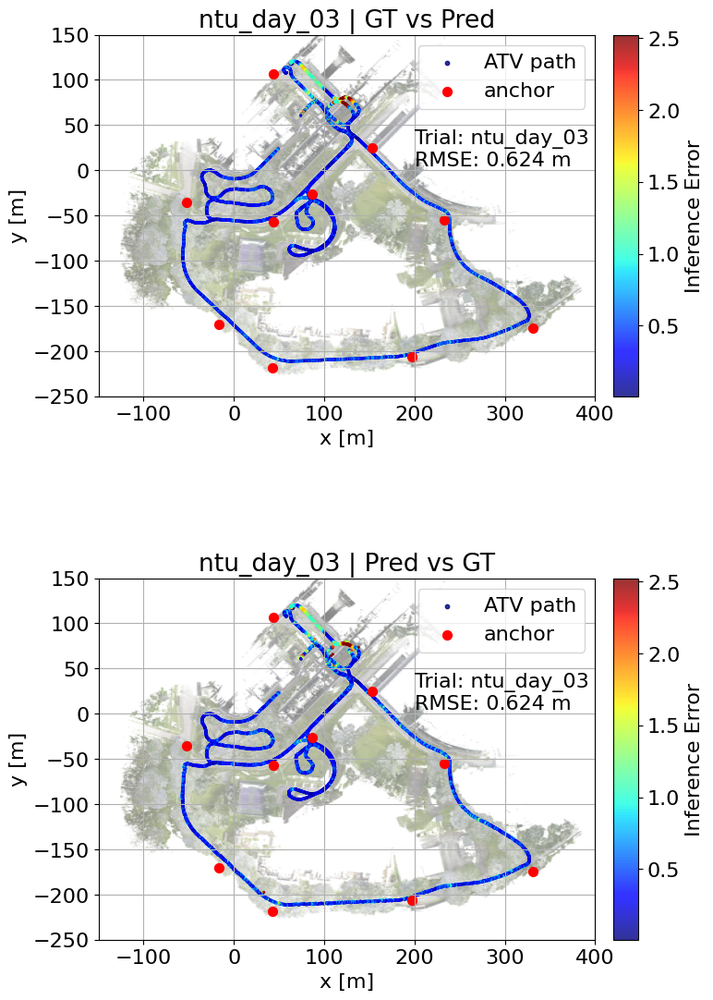


[PASS2] (4/23) Test & Plot: ntu_day_04
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_04_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_04_packed.csv. Size: 67
Number of samples: 6903
[RESULT] ntu_day_04 | RMSE ≈ 0.6949 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_04_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_04_pred_xyz.csv


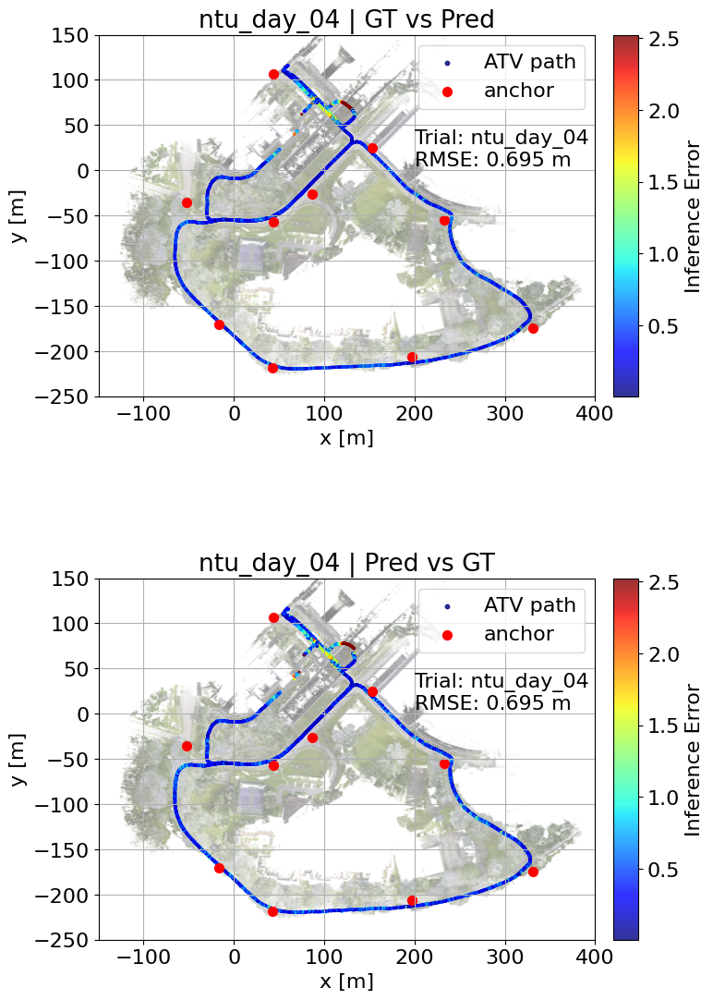


[PASS2] (5/23) Test & Plot: ntu_day_05
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_05_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_05_packed.csv. Size: 67
Number of samples: 4886
[RESULT] ntu_day_05 | RMSE ≈ 0.5626 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_05_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_05_pred_xyz.csv


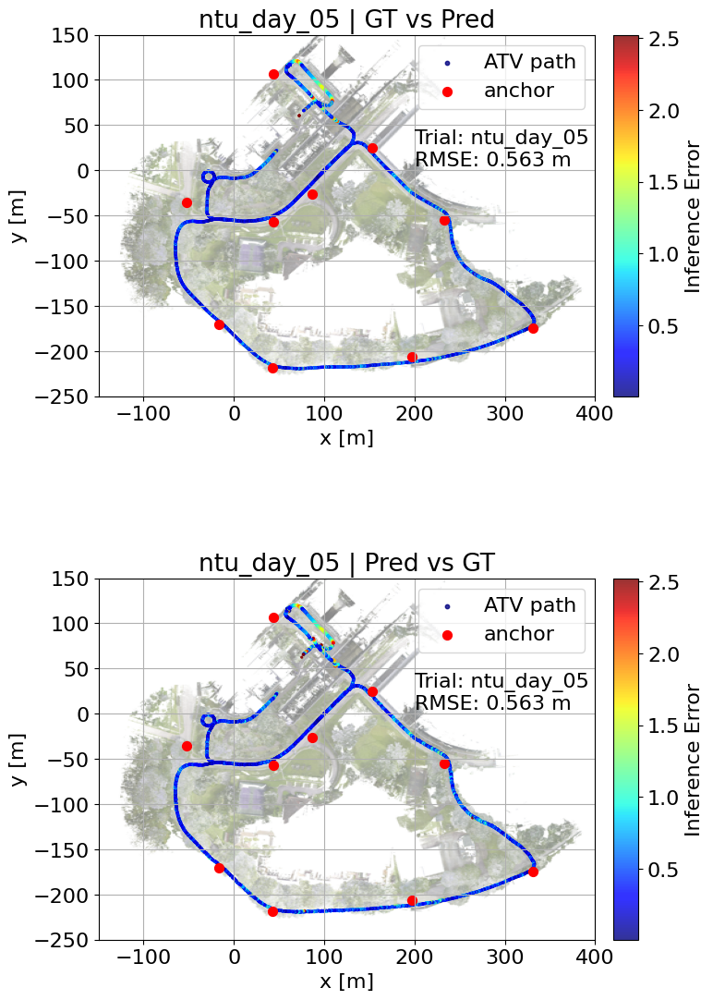


[PASS2] (6/23) Test & Plot: ntu_day_06
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_06_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_06_packed.csv. Size: 67
Number of samples: 5398
[RESULT] ntu_day_06 | RMSE ≈ 0.5556 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_06_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_06_pred_xyz.csv


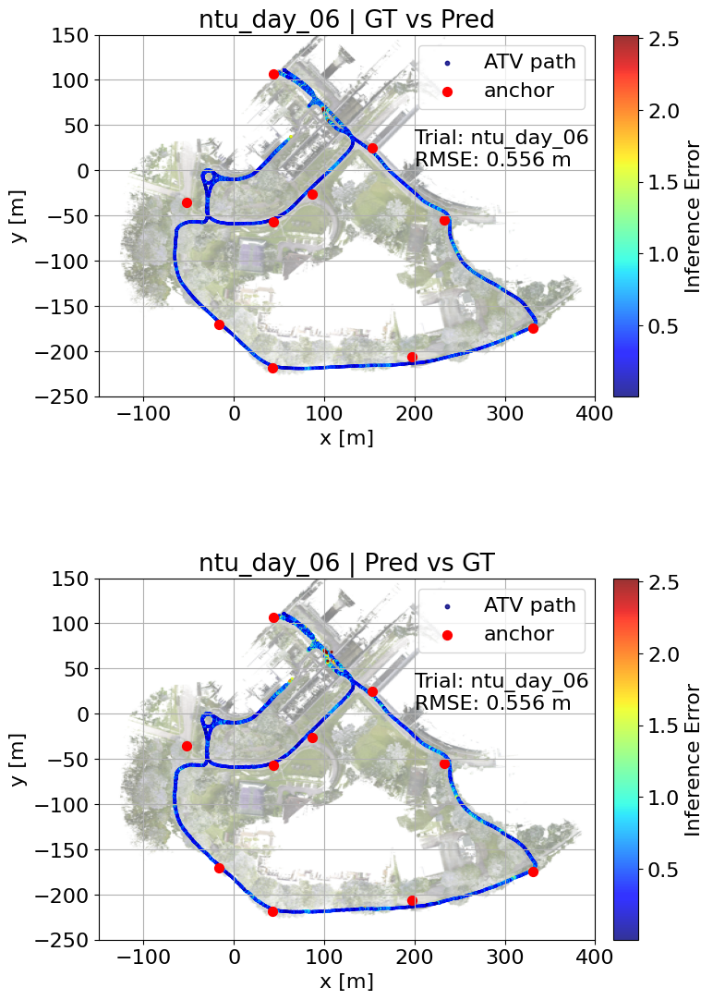


[PASS2] (7/23) Test & Plot: ntu_day_07
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_07_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_07_packed.csv. Size: 67
Number of samples: 10495
[RESULT] ntu_day_07 | RMSE ≈ 0.6049 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_07_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_07_pred_xyz.csv


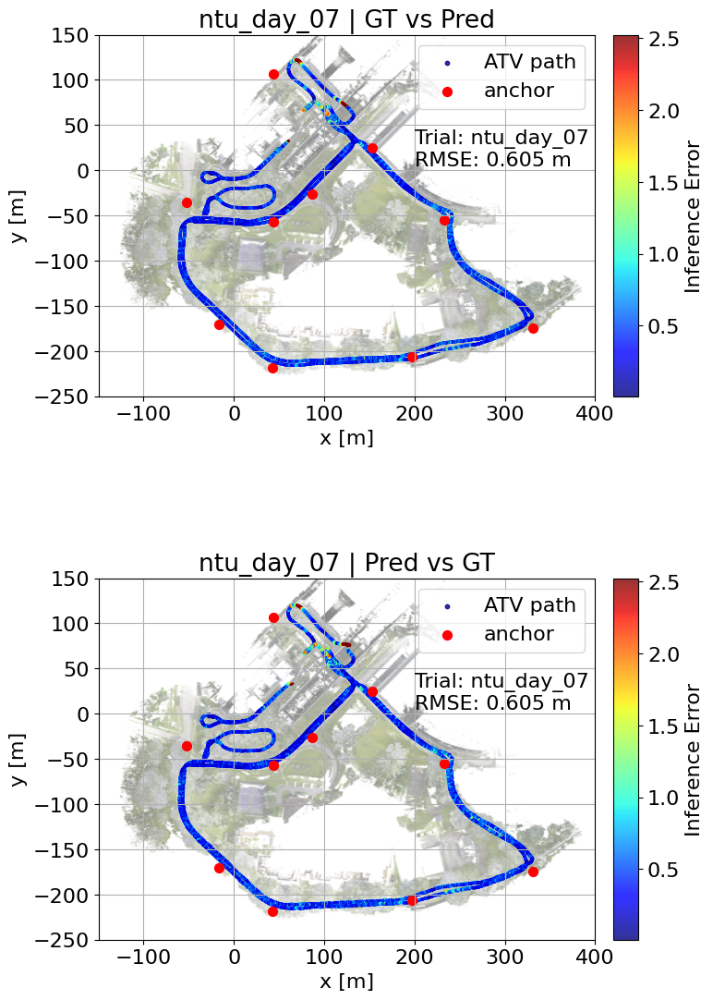


[PASS2] (8/23) Test & Plot: ntu_day_08
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_08_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_08_packed.csv. Size: 67
Number of samples: 10859
[RESULT] ntu_day_08 | RMSE ≈ 0.7988 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_08_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_08_pred_xyz.csv


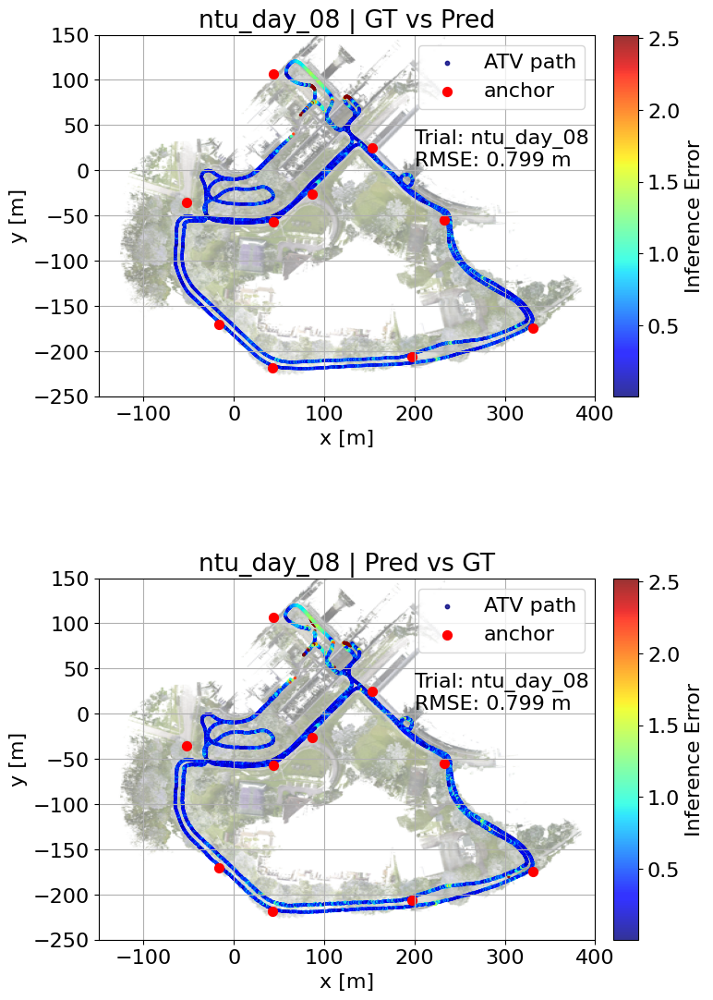


[PASS2] (9/23) Test & Plot: ntu_day_09
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_09_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_09_packed.csv. Size: 67
Number of samples: 6029
[RESULT] ntu_day_09 | RMSE ≈ 0.6361 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_09_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_09_pred_xyz.csv


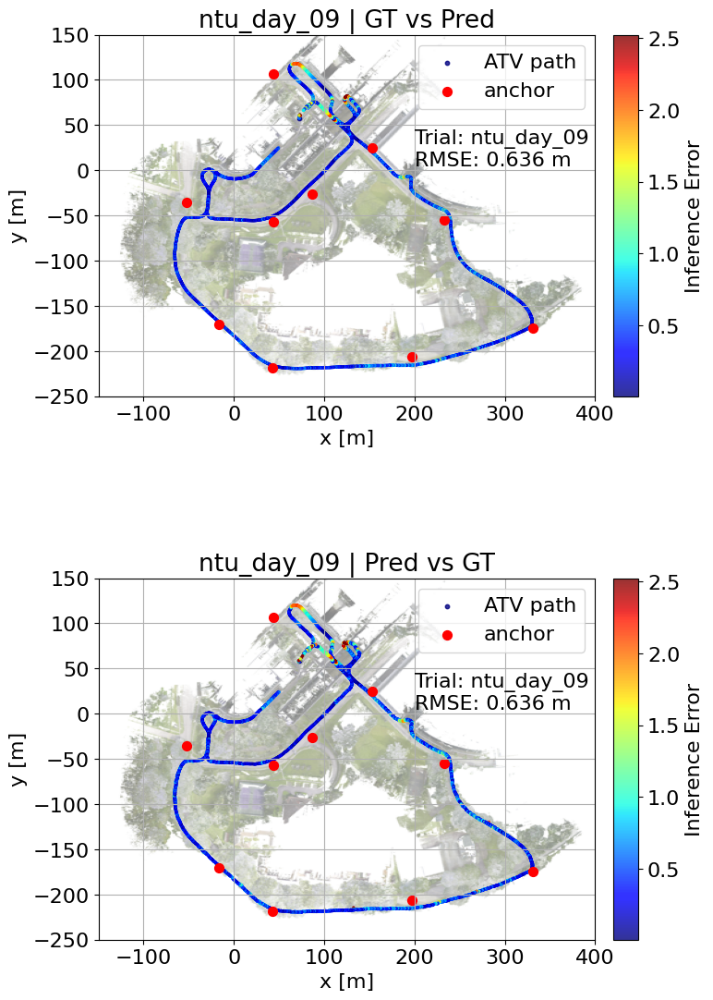


[PASS2] (10/23) Test & Plot: ntu_day_10
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_day_10_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_day_10_packed.csv. Size: 67
Number of samples: 6365
[RESULT] ntu_day_10 | RMSE ≈ 2.8246 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_10_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_day_10_pred_xyz.csv


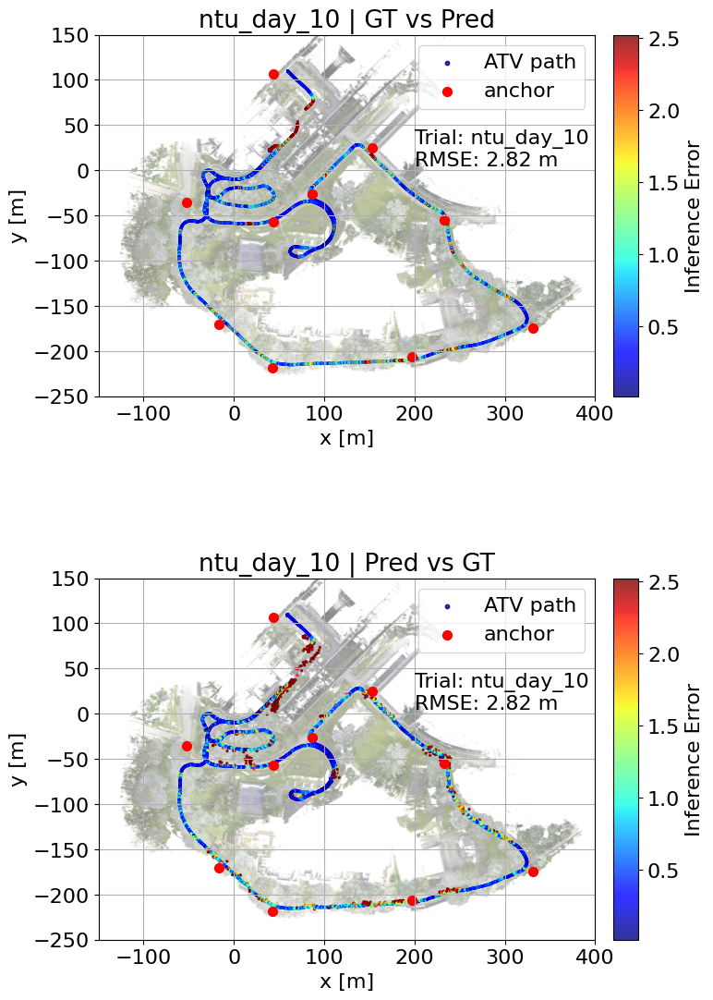


[PASS2] (11/23) Test & Plot: ntu_night_01
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_01_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_01_packed.csv. Size: 67
Number of samples: 7368
[RESULT] ntu_night_01 | RMSE ≈ 0.5704 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_01_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_01_pred_xyz.csv


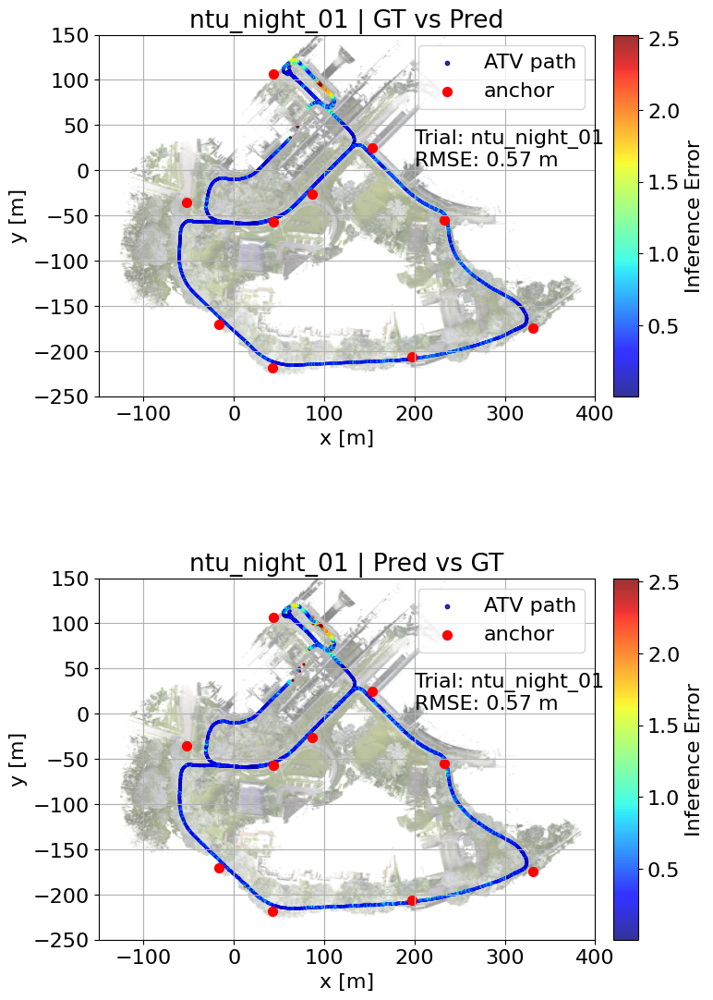


[PASS2] (12/23) Test & Plot: ntu_night_02
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_02_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_02_packed.csv. Size: 67
Number of samples: 13235
[RESULT] ntu_night_02 | RMSE ≈ 2.3895 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_02_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_02_pred_xyz.csv


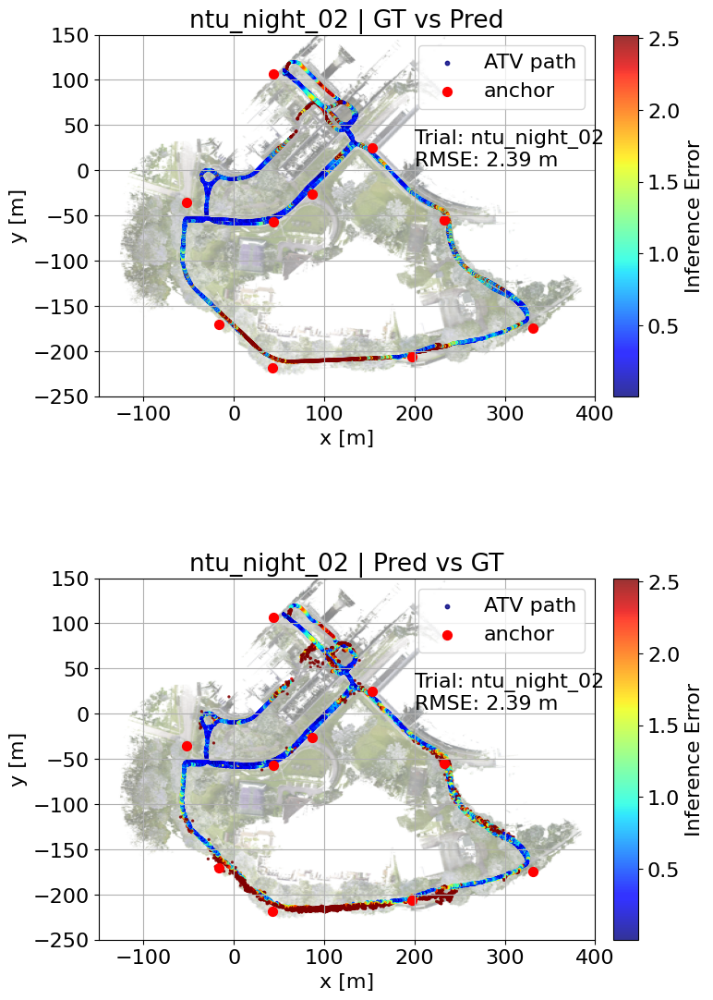


[PASS2] (13/23) Test & Plot: ntu_night_03
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_03_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_03_packed.csv. Size: 67
Number of samples: 6593
[RESULT] ntu_night_03 | RMSE ≈ 0.4772 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_03_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_03_pred_xyz.csv


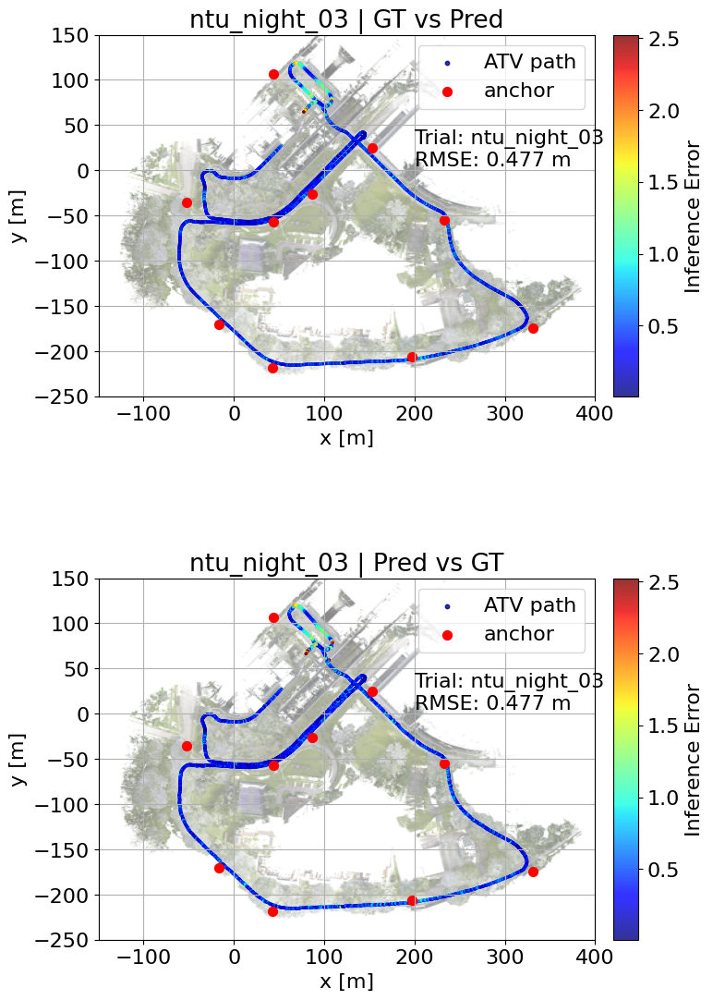


[PASS2] (14/23) Test & Plot: ntu_night_04
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_04_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_04_packed.csv. Size: 67
Number of samples: 5787
[RESULT] ntu_night_04 | RMSE ≈ 2.1109 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_04_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_04_pred_xyz.csv


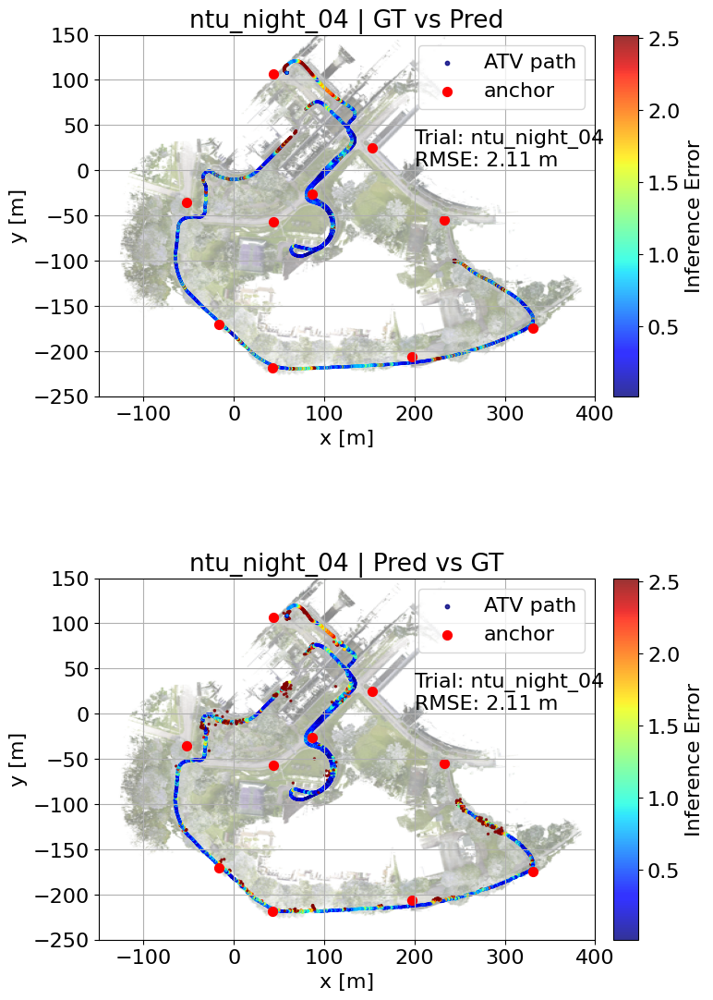


[PASS2] (15/23) Test & Plot: ntu_night_05
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_05_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_05_packed.csv. Size: 67
Number of samples: 10483
[RESULT] ntu_night_05 | RMSE ≈ 0.5224 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_05_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_05_pred_xyz.csv


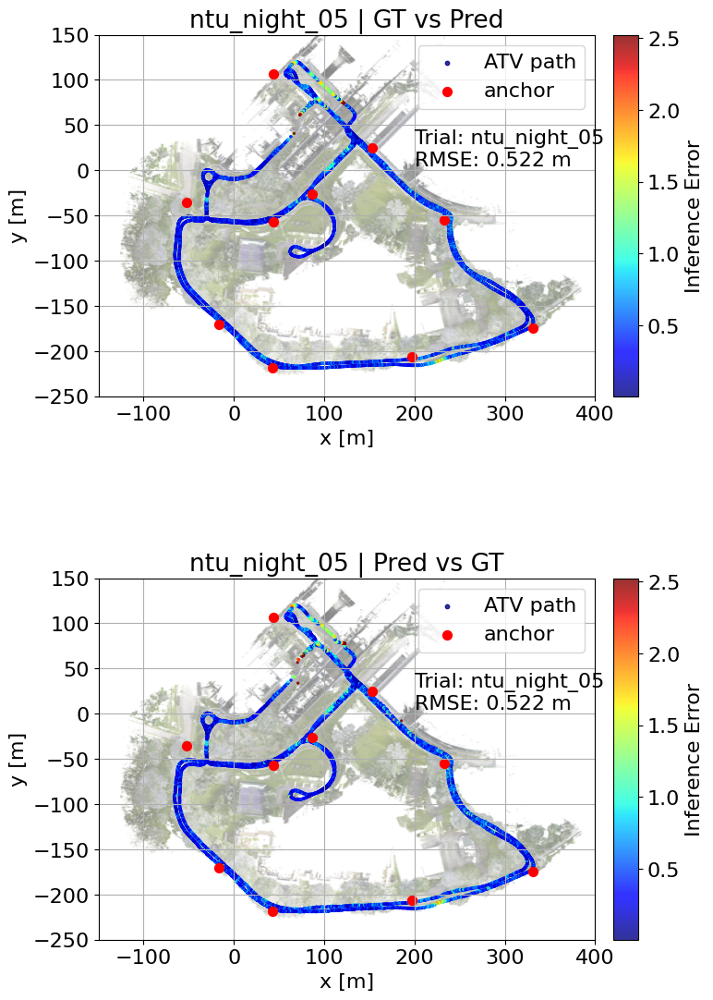


[PASS2] (16/23) Test & Plot: ntu_night_06
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_06_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_06_packed.csv. Size: 67
Number of samples: 9146
[RESULT] ntu_night_06 | RMSE ≈ 0.5493 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_06_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_06_pred_xyz.csv


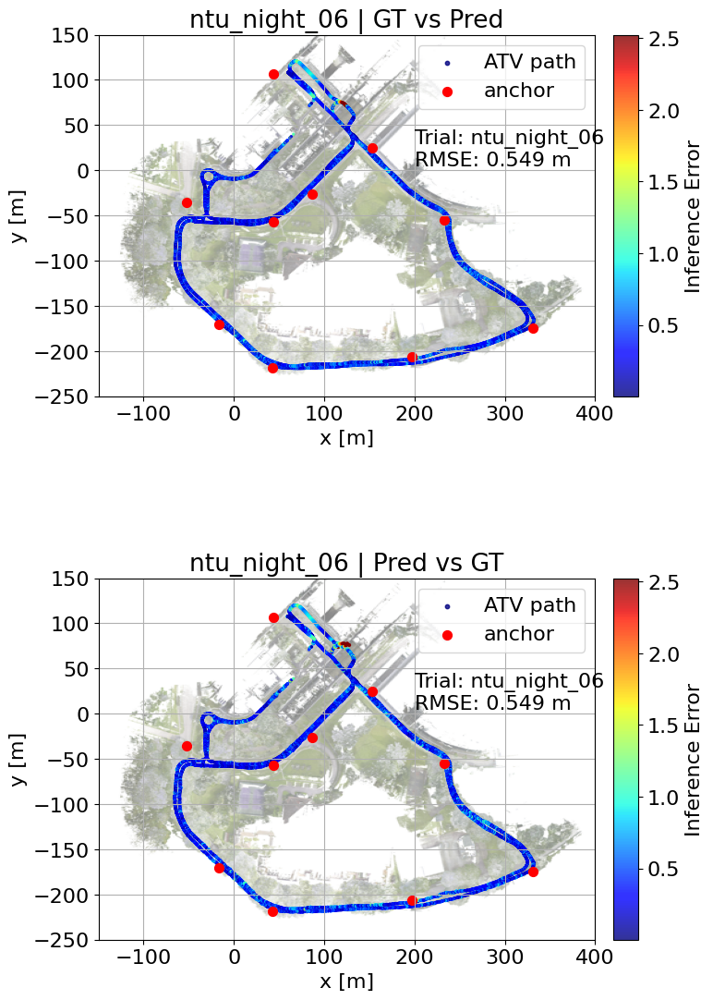


[PASS2] (17/23) Test & Plot: ntu_night_07
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_07_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_07_packed.csv. Size: 67
Number of samples: 7855
[RESULT] ntu_night_07 | RMSE ≈ 0.6025 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_07_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_07_pred_xyz.csv


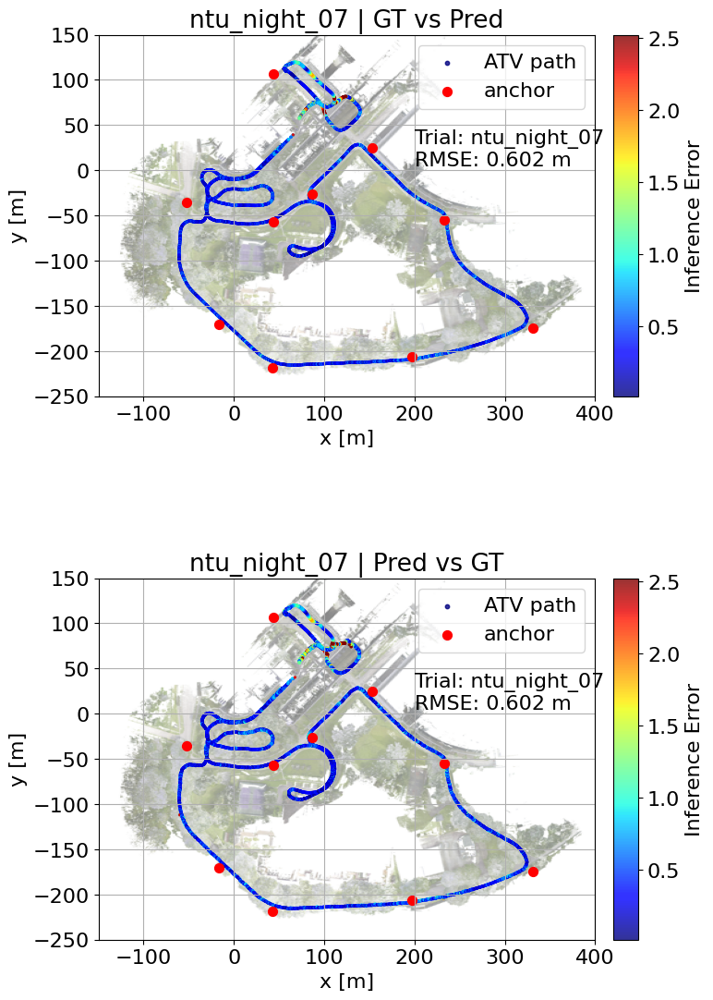


[PASS2] (18/23) Test & Plot: ntu_night_08
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_08_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_08_packed.csv. Size: 67
Number of samples: 8540
[RESULT] ntu_night_08 | RMSE ≈ 0.6529 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_08_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_08_pred_xyz.csv


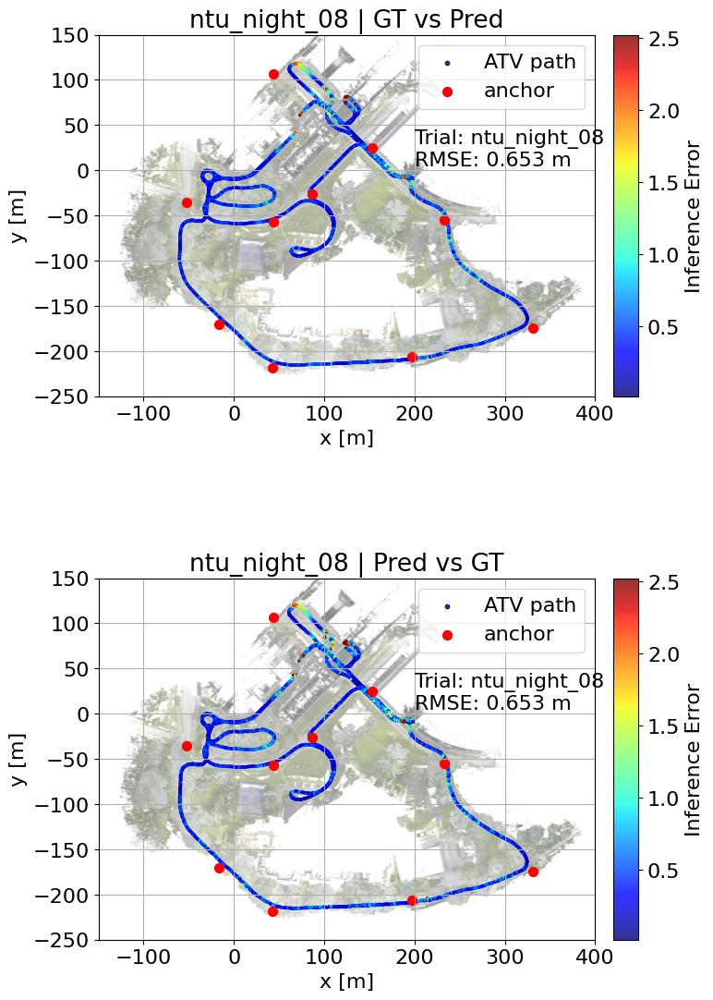


[PASS2] (19/23) Test & Plot: ntu_night_09
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_09_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_09_packed.csv. Size: 67
Number of samples: 4777
[RESULT] ntu_night_09 | RMSE ≈ 0.4731 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_09_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_09_pred_xyz.csv


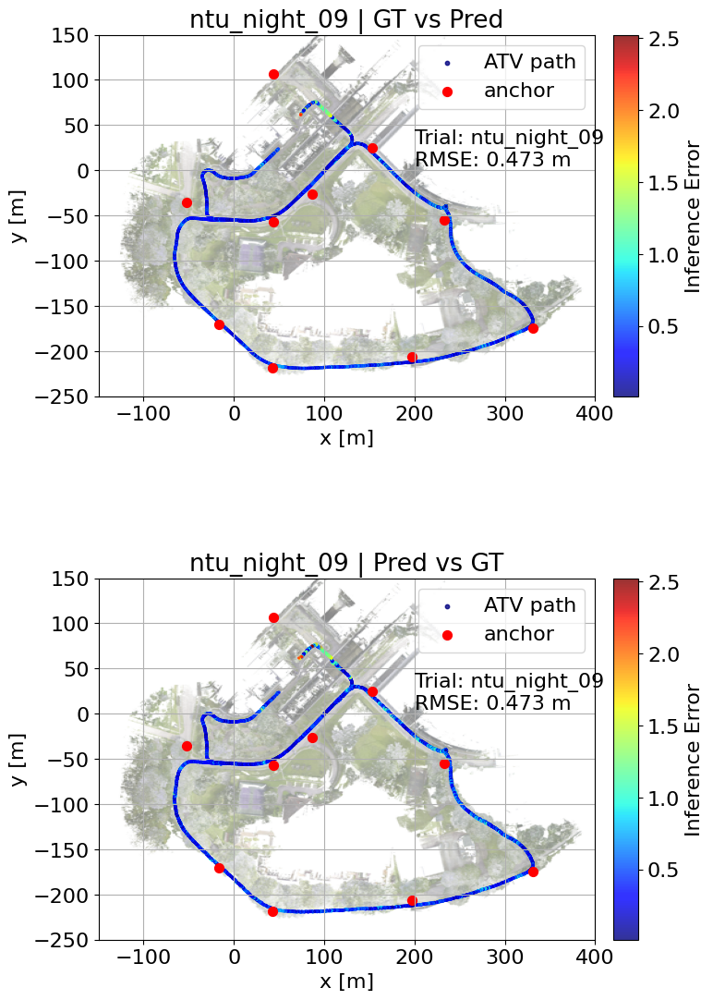


[PASS2] (20/23) Test & Plot: ntu_night_10
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_10_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_10_packed.csv. Size: 67
Number of samples: 8438
[RESULT] ntu_night_10 | RMSE ≈ 0.6119 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_10_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_10_pred_xyz.csv


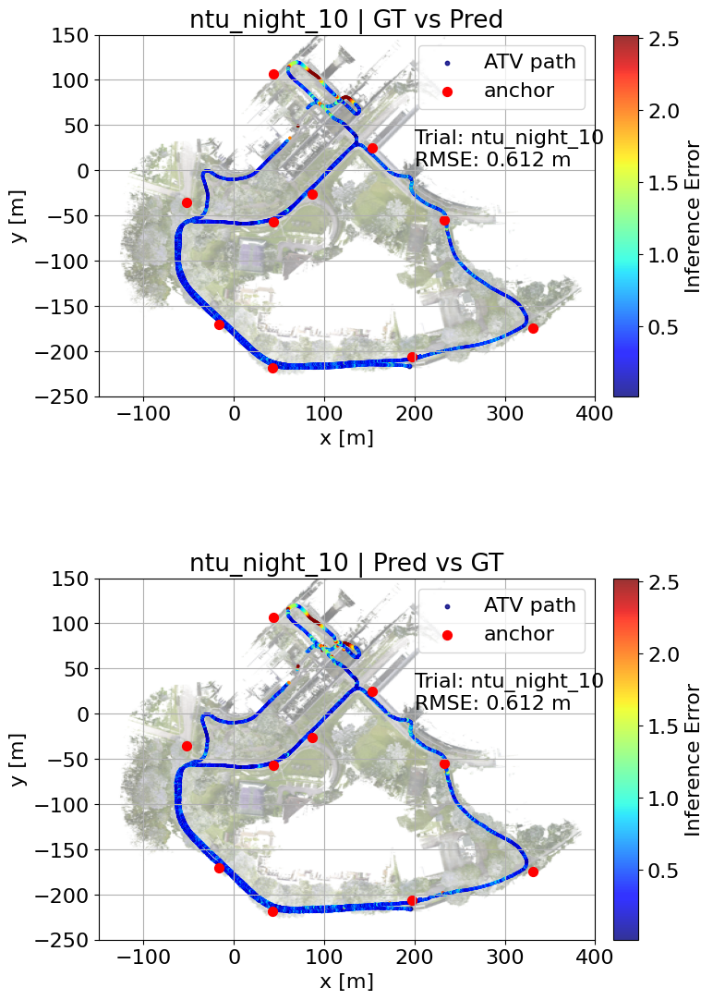


[PASS2] (21/23) Test & Plot: ntu_night_11
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_11_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_11_packed.csv. Size: 67
Number of samples: 7512
[RESULT] ntu_night_11 | RMSE ≈ 0.7711 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_11_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_11_pred_xyz.csv


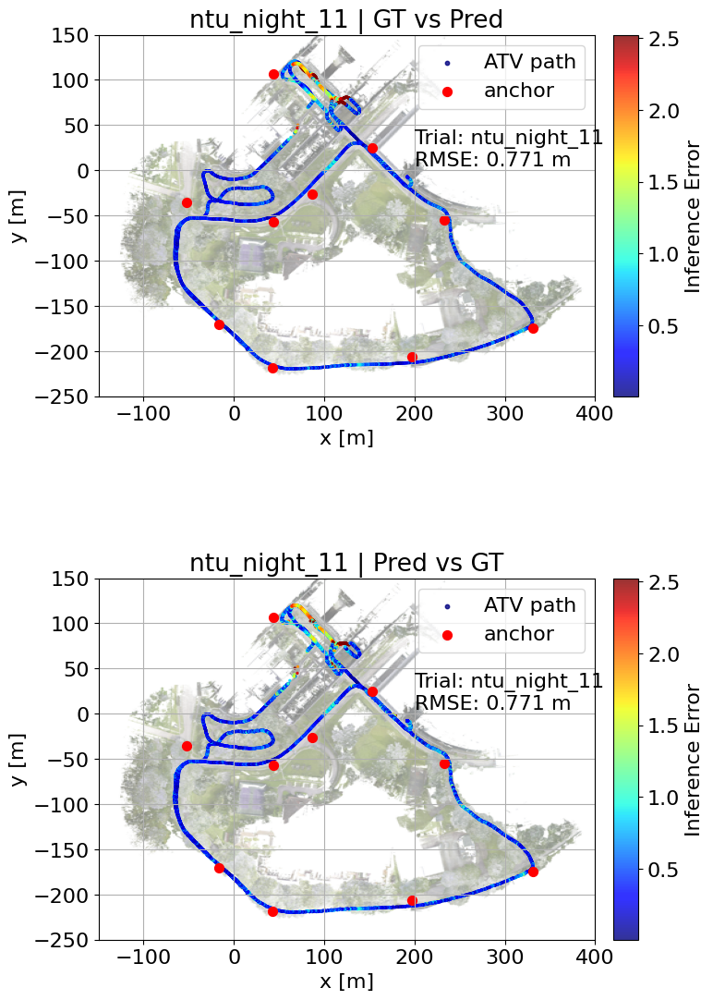


[PASS2] (22/23) Test & Plot: ntu_night_12
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_12_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_12_packed.csv. Size: 67
Number of samples: 4776
[RESULT] ntu_night_12 | RMSE ≈ 0.5053 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_12_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_12_pred_xyz.csv


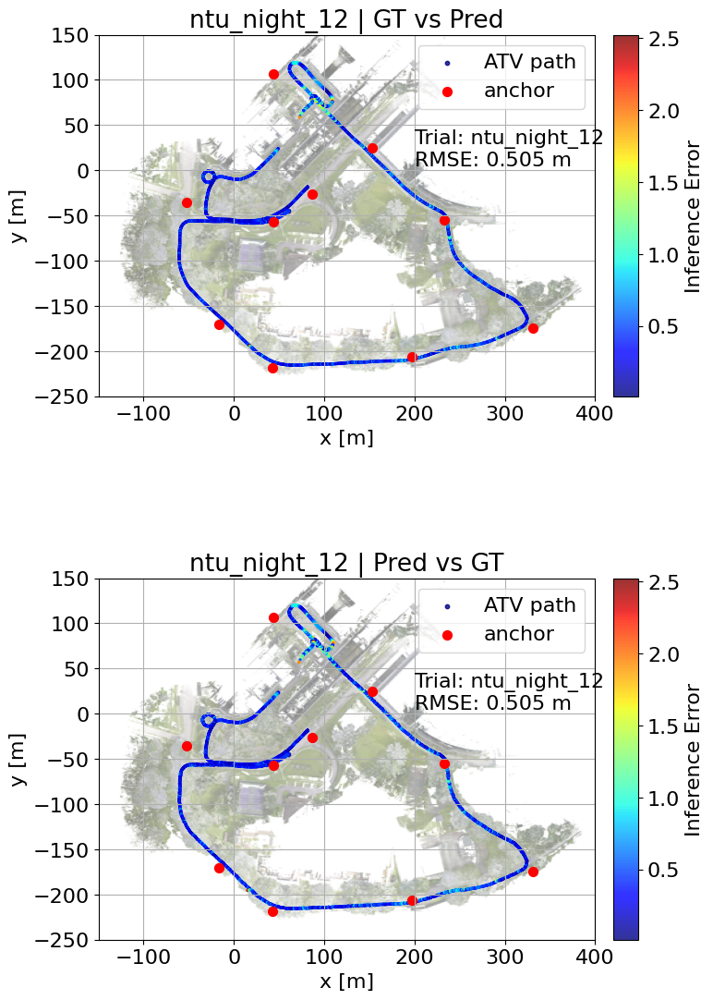


[PASS2] (23/23) Test & Plot: ntu_night_13
Path is not dir
['./data/MCDUWB_gndtruth/all/ntu_night_13_packed.csv']
Loading file ./data/MCDUWB_gndtruth/all/ntu_night_13_packed.csv. Size: 67
Number of samples: 4640
[RESULT] ntu_night_13 | RMSE ≈ 1.7676 m
[SAVE] GT XYZ   -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_13_gt_xyz.csv
[SAVE] PRED XYZ -> output/MCD/logs/MAMBA/xyz_logs_test/ntu_night_13_pred_xyz.csv


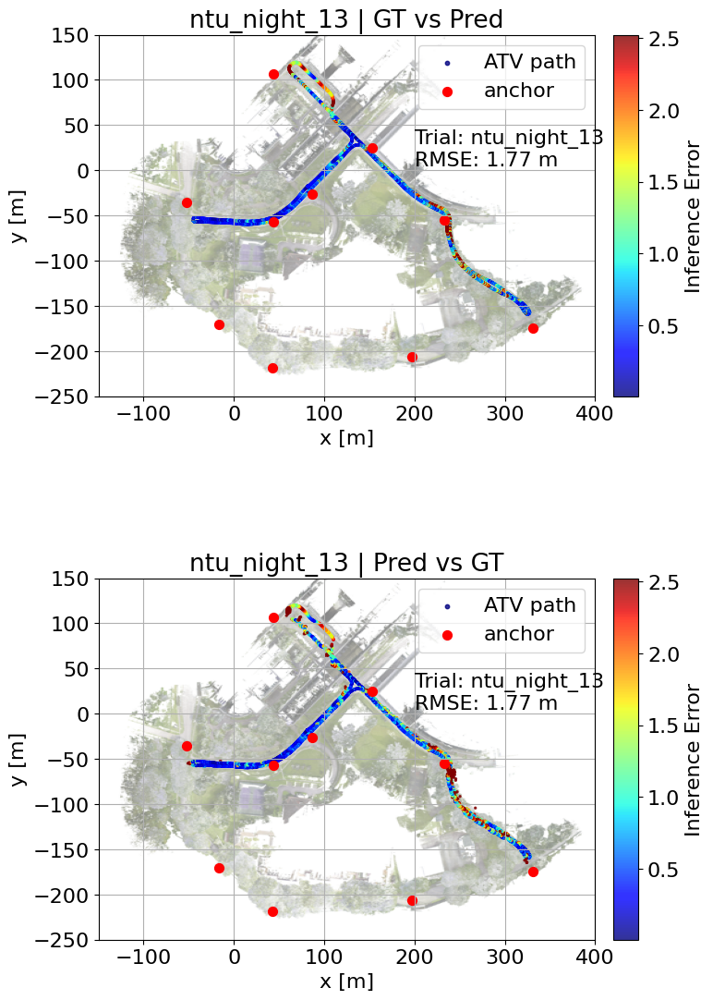


[INFO] Saved all errors to: output/MCD/logs/MAMBA/xyz_logs_test/all_test_errors.csv


In [33]:
import os
import glob
import math
import numpy as np
import pandas as pd
import torch
import matplotlib.pyplot as plt

from util.visualization import plotPathError

# =========================================================
# SETTINGS
# =========================================================
chunk_size = 1000
figsize = (8, 12)

# ------------------ Select test path ------------------
if train_on_slam:
    test_path = os.path.join(dataset_path, "MCDUWB_slamprior/test")
else:
    test_path = os.path.join(dataset_path, "MCDUWB_gndtruth/all")

test_seq = sorted(glob.glob(os.path.join(test_path, "*.csv")))
print("[INFO] Found test sequences:", len(test_seq))
for f in test_seq:
    print("  -", os.path.basename(f))

# ------------------ XYZ log folder ------------------
# log_dir đã có từ trước: output/{training_dataset}/logs/{training_model}
xyz_log_dir = os.path.join(log_dir, "xyz_logs_test")
os.makedirs(xyz_log_dir, exist_ok=True)
print("[INFO] XYZ logs will be saved to:", xyz_log_dir)

# =========================================================
# PASS 1: Compute GLOBAL error scale colorScalePiv
# =========================================================
model.eval()
all_err_global = []

with torch.no_grad():
    for seqidx, seq in enumerate(test_seq):
        seq_name = os.path.basename(seq).replace("_packed.csv", "")
        print(f"\n[PASS1] ({seqidx+1}/{len(test_seq)}) Compute global error scale for: {seq_name}")

        # Load dataset for this sequence
        seq_dataset = MCDLoader(
            seq,
            seqlen=seqlen,
            Xscaler=Xscaler,
            Yscaler=Yscaler,
            min_anc=min_anc,
            half=train_one_tag
        )

        X = seq_dataset.getX()   # torch tensor (N, L, D)
        Y = seq_dataset.getY()   # torch tensor (N, L, out_dim)

        total_data = X.shape[0]
        num_chunks = math.ceil(total_data / chunk_size)

        for i in range(num_chunks):
            s = i * chunk_size
            e = min((i + 1) * chunk_size, total_data)

            X_chunk = X[s:e, :, :]
            Y_chunk = Y[s:e, :, :]

            # ---- reconstruct GT trajectory points ----
            Y_chunk = torch.cat((Y_chunk[0, :, :], Y_chunk[:, -1, :]), dim=0)  # (L + B, dim)
            Y_chunk = Yscaler.inverse_transform(Y_chunk.cpu().numpy())

            # ---- predict ----
            Ypred_chunk = model(X_chunk.float().to(device)).cpu()
            Ypred_chunk = torch.cat((Ypred_chunk[0, :, :], Ypred_chunk[:, -1, :]), dim=0)
            Ypred_chunk = Yscaler.inverse_transform(Ypred_chunk.numpy())

            # ---- compute error ----
            chunk_res = Result(half=train_one_tag)
            chunk_res.evaluate(Ypred_chunk, Y_chunk)
            chunk_err = np.linalg.norm(chunk_res.abs_diff, axis=1)

            all_err_global.append(chunk_err)

            # ---- clear mem ----
            del X_chunk, Y_chunk, Ypred_chunk, chunk_res, chunk_err
            torch.cuda.empty_cache()

# Global clamp scale
all_err_global = np.concatenate(all_err_global)
mean = np.mean(all_err_global)
colorScalePiv = mean + 2 * np.var(all_err_global)

print("\n=====================================================")
print(f"[GLOBAL] mean error       = {mean:.6f}")
print(f"[GLOBAL] var(error)      = {np.var(all_err_global):.6f}")
print(f"[GLOBAL] colorScalePiv   = {colorScalePiv:.6f}")
print("=====================================================\n")

# =========================================================
# PASS 2: Inference + Plot + Save XYZ per sequence
# =========================================================
test_df = None  # store error distributions for all sequences

with torch.no_grad():
    for seqidx, seq in enumerate(test_seq):
        seq_name = os.path.basename(seq).replace("_packed.csv", "")
        print(f"\n[PASS2] ({seqidx+1}/{len(test_seq)}) Test & Plot: {seq_name}")

        # Load dataset for this sequence
        seq_dataset = MCDLoader(
            seq,
            seqlen=seqlen,
            Xscaler=Xscaler,
            Yscaler=Yscaler,
            min_anc=min_anc,
            half=train_one_tag
        )

        X = seq_dataset.getX()
        Y = seq_dataset.getY()

        total_data = X.shape[0]
        num_chunks = math.ceil(total_data / chunk_size)

        all_Y = []
        all_Ypred = []

        # ------------------ Chunk inference ------------------
        for i in range(num_chunks):
            s = i * chunk_size
            e = min((i + 1) * chunk_size, total_data)

            X_chunk = X[s:e, :, :]
            Y_chunk = Y[s:e, :, :]

            # GT
            Y_chunk = torch.cat((Y_chunk[0, :, :], Y_chunk[:, -1, :]), dim=0)
            Y_chunk = Yscaler.inverse_transform(Y_chunk.cpu().numpy())

            # Pred
            Ypred_chunk = model(X_chunk.float().to(device)).cpu()
            Ypred_chunk = torch.cat((Ypred_chunk[0, :, :], Ypred_chunk[:, -1, :]), dim=0)
            Ypred_chunk = Yscaler.inverse_transform(Ypred_chunk.numpy())

            all_Y.append(Y_chunk)
            all_Ypred.append(Ypred_chunk)

            del X_chunk, Y_chunk, Ypred_chunk
            torch.cuda.empty_cache()

        # Combine results
        all_Y = np.vstack(all_Y)
        all_Ypred = np.vstack(all_Ypred)

        # ------------------ Evaluate full-seq errors ------------------
        seq_res = Result(half=train_one_tag)
        seq_res.evaluate(all_Ypred, all_Y)

        # Error norm (pose error vector norm)
        err = np.linalg.norm(seq_res.abs_diff, axis=1)

        # RMSE for printing
        rmse = np.sqrt(np.mean(err**2))
        print(f"[RESULT] {seq_name} | RMSE ≈ {rmse:.4f} m")

        # Save error distribution to df
        df = pd.DataFrame(err, columns=["error"])
        df["seq"] = seq_name
        test_df = df if test_df is None else pd.concat([test_df, df], ignore_index=True)

        # =====================================================
        # SAVE XYZ LOGS (GT + PRED)
        # =====================================================
        # Assume first 3 dims are xyz
        gt_xyz = all_Y[:, :3]
        pred_xyz = all_Ypred[:, :3]
        xyz_err = np.linalg.norm(pred_xyz - gt_xyz, axis=1)

        df_gt = pd.DataFrame(gt_xyz, columns=["x", "y", "z"])
        df_pred = pd.DataFrame(pred_xyz, columns=["x", "y", "z"])

        # Add index to keep order
        df_gt.insert(0, "idx", np.arange(len(df_gt)))
        df_pred.insert(0, "idx", np.arange(len(df_pred)))
        df_pred["error_xyz"] = xyz_err

        gt_save_path = os.path.join(xyz_log_dir, f"{seq_name}_gt_xyz.csv")
        pred_save_path = os.path.join(xyz_log_dir, f"{seq_name}_pred_xyz.csv")

        df_gt.to_csv(gt_save_path, index=False)
        df_pred.to_csv(pred_save_path, index=False)

        print(f"[SAVE] GT XYZ   -> {gt_save_path}")
        print(f"[SAVE] PRED XYZ -> {pred_save_path}")

        # =====================================================
        # PLOT (2 rows like your code)
        # =====================================================
        fig, ax = plt.subplots(nrows=2, ncols=1, figsize=figsize)

        # Plot GT vs Pred (colored by error scale)
        plotPathError(all_Y, all_Ypred, ax[0], colorScalePiv, train_on_slam, train_one_tag, trial=seq_name)

        # Plot Pred vs GT (reverse order if you want)
        plotPathError(all_Ypred, all_Y, ax[1], colorScalePiv, train_on_slam, train_one_tag, trial=seq_name)

        ax[0].set_title(f"{seq_name} | GT vs Pred")
        ax[1].set_title(f"{seq_name} | Pred vs GT")
        plt.tight_layout()
        plt.show()

# =========================================================
# OPTIONAL: Save global test error CSV summary
# =========================================================
if test_df is not None:
    summary_path = os.path.join(xyz_log_dir, "all_test_errors.csv")
    test_df.to_csv(summary_path, index=False)
    print("\n[INFO] Saved all errors to:", summary_path)


### Plot the violin plot

In [ ]:
import colorsys

# Map sequence to camp (here it's 'mcd')
test_df['camp'] = test_df['seq'].apply(lambda x: 'mcd')

# Get the list of sequences and sort them
sequences = sorted(list(set(test_df['seq'])))
Nseq = len(sequences)

# Generate colors for each sequence
colors = []
for i in range(Nseq):
    rgb = colorsys.hsv_to_rgb(i / Nseq, 0.5, 1.0)
    colors.append(rgb)

figsize = (8, 5)
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=figsize)
dx = 'seq'
dy = 'error'
sigma = 0.6
ort = "v"
cut = 0.0

# Plot the violin plots
for idx, seq in enumerate(sequences):
    df = test_df[test_df['seq'] == seq].copy()
    df['xtick'] = df['seq'].apply(lambda x: -1)  # xtick position for violin plot

    # Draw violin plot
    violin = sns.violinplot(
        ax=ax, x='xtick', y=dy, data=df, scale="width", inner=None, color=colors[idx]
    )

    # Modify to only draw half of the violin
    v = violin.collections[-1]
    m = np.mean(v.get_paths()[0].vertices[:, 0])
    v.get_paths()[0].vertices[:, 0] = np.clip(v.get_paths()[0].vertices[:, 0], -np.inf, m)
    v.set_edgecolor('none')

    plt.xticks([-1], [''])

# Plot the box plots
for idx, seq in enumerate(sequences):
    df = test_df[test_df['seq'] == seq].copy()
    df['xtick'] = idx  # xtick position for box plot

    ax.boxplot(
        df['error'],
        positions=[0.25 + idx * 0.25],
        patch_artist=True,
        medianprops=dict(color='black'),
        boxprops=dict(facecolor=colors[idx], edgecolor='none'),
        showfliers=False
    )
    plt.xticks([-1], [''])

# Add legend
handles = [plt.Line2D([], [], color=color, marker='s', linestyle='None') for color in colors]
labels = [seq.replace('mcd_', '') for seq in sequences]  # Labels for each sequence

# ax.legend(handles, labels)

# Format the plot
ax.set_xlim([-0.5, 1.5])
ax.set_ylim([0, 10])

ax.set_xlabel('mcd test sequences')
ax.set_ylabel('Inference Error [m]')

ax.grid(True)
plt.tight_layout()
plt.show()